In [1]:
import numpy as np
import pandas as pd
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras.utils import plot_model
import matplotlib.pyplot as plt
from tensorflow.keras.datasets import mnist
from tensorflow.keras.layers import Dense, Reshape, Flatten, BatchNormalization, LeakyReLU, Dropout, Input
from tensorflow.keras.models import Sequential, load_model
import tensorflow.keras.backend as K
from keras import Input, Model, callbacks
from keras.metrics import Mean
from tensorflow.keras.optimizers import Adam

In [2]:
ROWS = 28
COLS = 28
CHANNELS = 1
IMG_SHAPE = (ROWS, COLS, CHANNELS)
BATCH_SIZE = 128
NOISE_SIZE = 32
EPOCHS = 500
EPOCHS_TO_SAVE = 50

In [3]:
def show_images(images, n_cols, title, filename):
    n_rows = (len(images) - 1) // n_cols + 1
    
    fig = plt.figure(figsize = (n_cols, n_rows))
    for index, img in enumerate(images):
        plt.subplot(n_rows, n_cols, index + 1)
        plt.imshow(img, cmap = "binary")
        plt.axis("off")
    plt.suptitle(title)
    
    fig.savefig(filename +".png")
    plt.show()

In [4]:
def prepare_mnist_dataset():
    (x_train, y_train), (x_test, y_test) = mnist.load_data()
    
    x_full = np.concatenate([x_train, x_test])
    y_full = np.concatenate([y_train, y_test])
    
    x_full = x_full.astype(np.float32) / 255
    x_full = x_full.reshape(-1, 28, 28, 1) * 2. - 1.
    
    return x_full, y_full

In [5]:
def prepare_mnist_batch(x_full, y_full,  num_label, batch_size):
    x_label = x_full[np.where(y_full == num_label)]
    
    dataset = tf.data.Dataset.from_tensor_slices(x_label)
    dataset = dataset.shuffle(1024)
    
    dataset = dataset.batch(batch_size, drop_remainder = True).prefetch(1) 
    
    return dataset

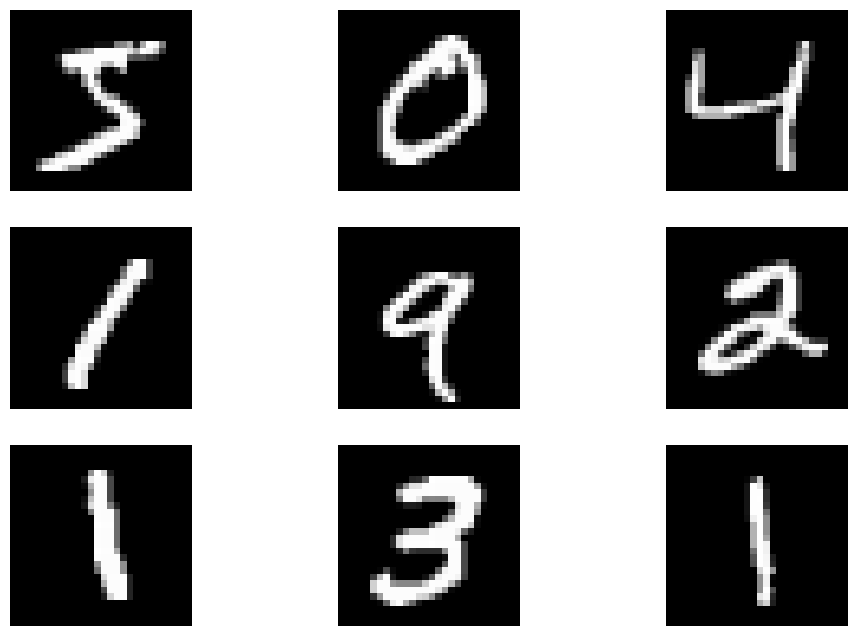

In [6]:
x_train, y_train = prepare_mnist_dataset()

plt.figure(figsize=(12, 8))
for i in range(9):
    plt.subplot(3, 3, i + 1)
    plt.imshow(x_train[i], cmap="gray")
    plt.axis("off")
plt.show()

In [7]:
def build_generator():
    return keras.models.Sequential([
    Input(shape = [NOISE_SIZE]),
    
    Dense(64),
    LeakyReLU(alpha = 0.2),
    BatchNormalization(momentum = 0.8),
        
    Dense(128),
    LeakyReLU(alpha = 0.2),
    BatchNormalization(momentum = 0.8),
        
    Dense(256),
    LeakyReLU(alpha = 0.2),
    BatchNormalization(momentum = 0.8),
    
    Dense(512),
    LeakyReLU(alpha = 0.2),
    BatchNormalization(momentum = 0.8),
    
    Dense(1024),
    LeakyReLU(alpha = 0.2),
    BatchNormalization(momentum = 0.8),
    
    Dense(np.prod(IMG_SHAPE), activation = 'tanh'),
    Reshape(IMG_SHAPE)
], name = 'generator')

In [8]:
def build_discriminator():
    return keras.models.Sequential([
    Flatten(input_shape = IMG_SHAPE),
        
    Dense(512),
    LeakyReLU(alpha = 0.2),
    Dropout(rate = 0.3),
    
    Dense(256),
    LeakyReLU(alpha = 0.2),
    Dropout(rate = 0.3),
    
    Dense(1, activation = 'sigmoid')
], name = 'discriminator')

In [9]:
class GAN(Model):
    def __init__(self, discriminator, generator, latent_dim):
        super().__init__()
        self.discriminator = discriminator
        self.generator = generator
        self.latent_dim = latent_dim

    def compile(self, discriminator_optimizer, generator_optimizer, loss_fn):
        super().compile()
        self.discriminator_optimizer = discriminator_optimizer
        self.generator_optimizer = generator_optimizer
        self.loss_fn = loss_fn
        self.discriminator_loss_metric = keras.metrics.Mean(name = "discriminator_loss")
        self.generator_loss_metric = keras.metrics.Mean(name = "generator_loss")

    @property
    def metrics(self):
        return [self.discriminator_loss_metric, self.generator_loss_metric]

    def train_step(self, real_images):
        
        batch_size = tf.shape(real_images)[0]
        random_latent_vectors = tf.random.normal(shape = (batch_size, self.latent_dim))
        
        generated_images = self.generator(random_latent_vectors)
        combined_images = tf.concat([generated_images, real_images], axis = 0)
        labels = tf.concat(
            [tf.ones((batch_size, 1)), tf.zeros((batch_size, 1))], axis = 0
        )
        labels += 0.05 * tf.random.uniform(tf.shape(labels))

        
        with tf.GradientTape() as tape:
            predictions = self.discriminator(combined_images) 
            discriminator_loss = self.loss_fn(labels, predictions)
        gradients = tape.gradient(discriminator_loss, self.discriminator.trainable_weights)
        self.discriminator_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_weights))

        random_latent_vectors = tf.random.normal(shape = (batch_size, self.latent_dim))
        misleading_labels = tf.zeros((batch_size, 1))

        
        with tf.GradientTape() as tape:
            predictions = self.discriminator(self.generator(random_latent_vectors))
            generator_loss = self.loss_fn(misleading_labels, predictions)
        gradients = tape.gradient(generator_loss, self.generator.trainable_weights)
        self.generator_optimizer.apply_gradients(zip(gradients, self.generator.trainable_weights))

        
        self.generator_loss_metric.update_state(generator_loss)
        self.discriminator_loss_metric.update_state(discriminator_loss)
        
        return {
            "discriminator_loss": self.discriminator_loss_metric.result(),
            "generator_loss": self.generator_loss_metric.result(),
        }

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 64)                2112      
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 64)                0         
                                                                 
 batch_normalization (BatchN  (None, 64)               256       
 ormalization)                                                   
                                                                 
 dense_1 (Dense)             (None, 128)               8320      
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 128)               0         
                                                                 
 batch_normalization_1 (Batc  (None, 128)              512       
 hNormalization)                                         

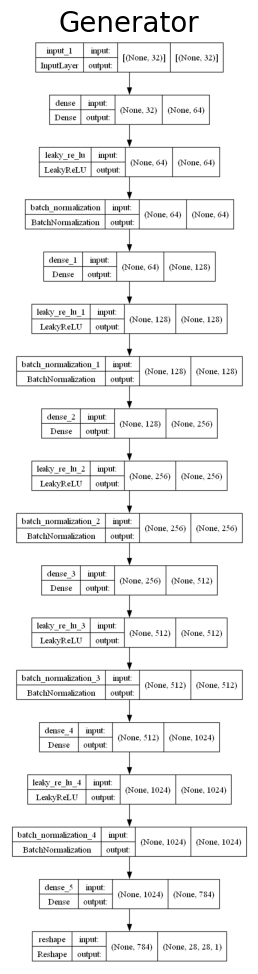

Model: "discriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten (Flatten)           (None, 784)               0         
                                                                 
 dense_6 (Dense)             (None, 512)               401920    
                                                                 
 leaky_re_lu_5 (LeakyReLU)   (None, 512)               0         
                                                                 
 dropout (Dropout)           (None, 512)               0         
                                                                 
 dense_7 (Dense)             (None, 256)               131328    
                                                                 
 leaky_re_lu_6 (LeakyReLU)   (None, 256)               0         
                                                                 
 dropout_1 (Dropout)         (None, 256)             

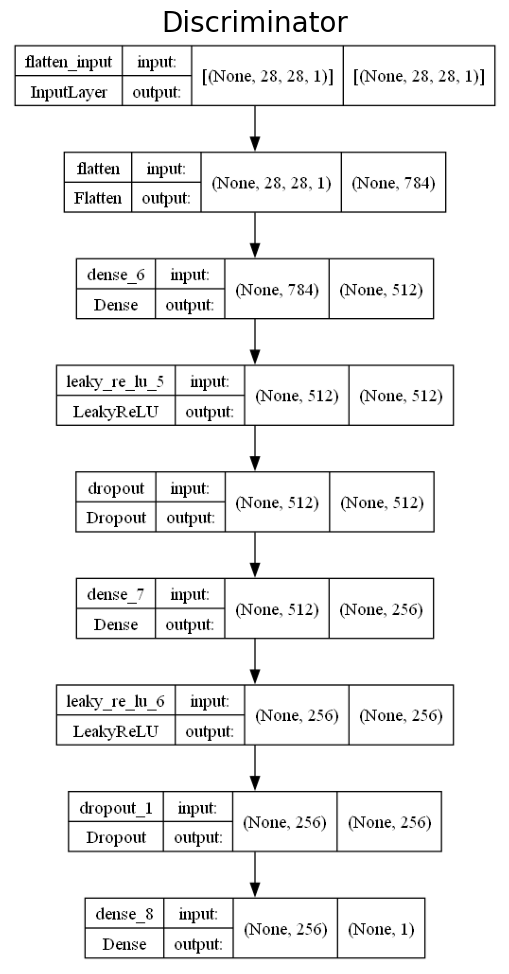

In [10]:
generator = build_generator()
generator.summary()
plot_model(generator, show_shapes = True, expand_nested = True, to_file = 'generator_scheme.png')
fig, ax = plt.subplots(1, 1, figsize = (20, 12))
ax.imshow(plt.imread('generator_scheme.png'))
ax.set_title('Generator', fontsize = 20)
ax.axis('off')
plt.show()

discriminator = build_discriminator()
discriminator.summary()
plot_model(discriminator, show_shapes = True, expand_nested = True, to_file = 'discriminator_scheme.png')
fig, ax = plt.subplots(1, 1, figsize = (20, 12))
ax.imshow(plt.imread('discriminator_scheme.png'))
ax.set_title('Discriminator', fontsize = 20)
ax.axis('off')
plt.show()

In [11]:
class save_imgs(callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        if ((int(epoch) + 1) % EPOCHS_TO_SAVE) == 0:
            fake_images = generator(tf.random.normal([64, NOISE_SIZE]))
            show_images(fake_images, 16, 'Images generated after {} epochs for class {}'.format(int(epoch) + 1, i), "gen_imgs_{}_{}".format(i, int(epoch) + 1))

Epoch 1/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6261 - generator_loss: 0.7766
Epoch 2/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.5796 - generator_loss: 0.8205
Epoch 3/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6682 - generator_loss: 0.8947
Epoch 4/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6122 - generator_loss: 0.9684
Epoch 5/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.5440 - generator_loss: 1.0394
Epoch 6/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.4564 - generator_loss: 1.1040
Epoch 7/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.4962 - generator_loss: 1.1184
Epoch 8/500
53/53 [==============================] - 1s 11ms/step - discriminator_loss: 0.5983 - generator_loss: 1.1714
Epoch 9/500
53/53 [=====================

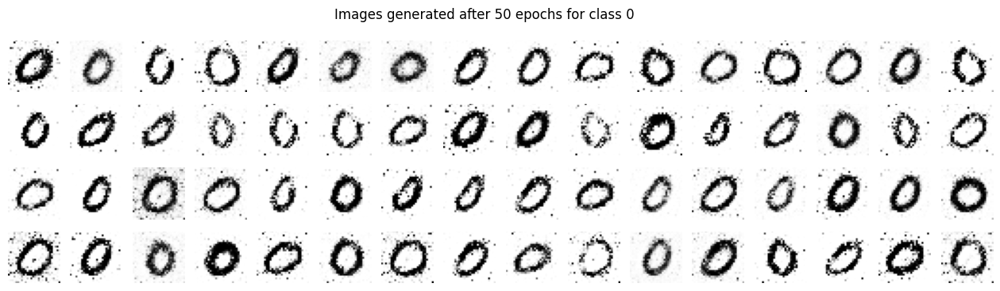

53/53 [==============================] - 2s 30ms/step - discriminator_loss: 0.5922 - generator_loss: 1.0593
Epoch 51/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.5960 - generator_loss: 1.0761
Epoch 52/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6150 - generator_loss: 1.0430
Epoch 53/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6371 - generator_loss: 1.0527
Epoch 54/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.5953 - generator_loss: 1.1008
Epoch 55/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6045 - generator_loss: 1.0629
Epoch 56/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.5877 - generator_loss: 1.0845
Epoch 57/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.5985 - generator_loss: 1.0595
Epoch 58/500
53/53 [=========================

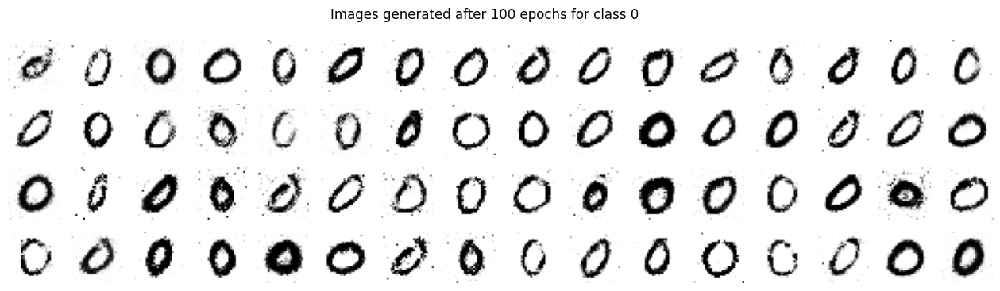

53/53 [==============================] - 1s 28ms/step - discriminator_loss: 0.6667 - generator_loss: 0.9058
Epoch 101/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6716 - generator_loss: 0.8867
Epoch 102/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6737 - generator_loss: 0.8904
Epoch 103/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6597 - generator_loss: 0.8866
Epoch 104/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6557 - generator_loss: 0.8976
Epoch 105/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6589 - generator_loss: 0.8787
Epoch 106/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6541 - generator_loss: 0.8971
Epoch 107/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6776 - generator_loss: 0.8870
Epoch 108/500
53/53 [=================

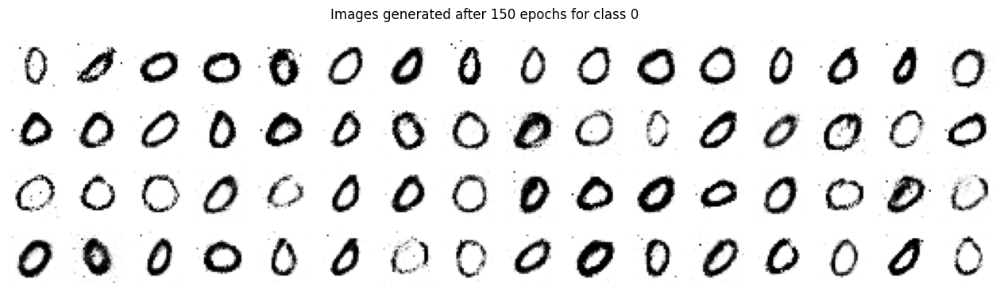

53/53 [==============================] - 1s 28ms/step - discriminator_loss: 0.6734 - generator_loss: 0.8557
Epoch 151/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6729 - generator_loss: 0.8449
Epoch 152/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6757 - generator_loss: 0.8649
Epoch 153/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6727 - generator_loss: 0.8642
Epoch 154/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6705 - generator_loss: 0.8607
Epoch 155/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6797 - generator_loss: 0.8590
Epoch 156/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6782 - generator_loss: 0.8860
Epoch 157/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6768 - generator_loss: 0.8564
Epoch 158/500
53/53 [=================

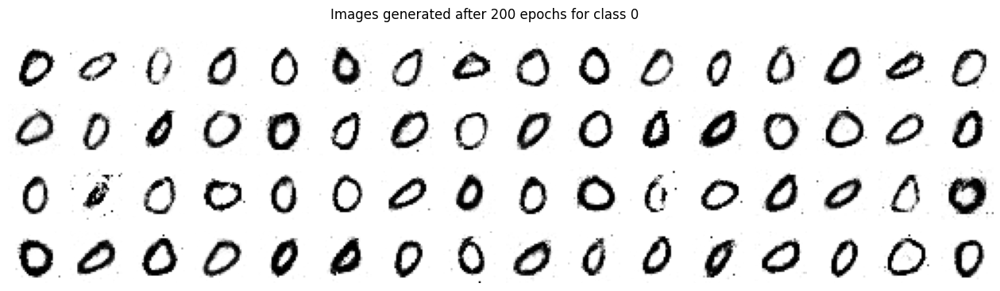

53/53 [==============================] - 1s 28ms/step - discriminator_loss: 0.6749 - generator_loss: 0.8409
Epoch 201/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6784 - generator_loss: 0.8466
Epoch 202/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6777 - generator_loss: 0.8407
Epoch 203/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6803 - generator_loss: 0.8434
Epoch 204/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6770 - generator_loss: 0.8433
Epoch 205/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6726 - generator_loss: 0.8463
Epoch 206/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6787 - generator_loss: 0.8456
Epoch 207/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6758 - generator_loss: 0.8372
Epoch 208/500
53/53 [=================

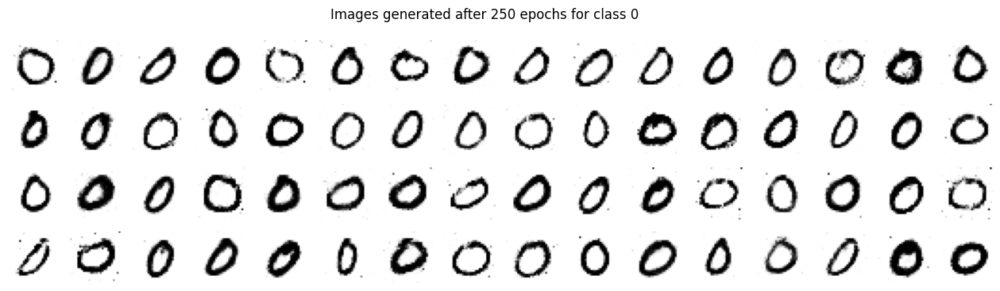

53/53 [==============================] - 2s 30ms/step - discriminator_loss: 0.6743 - generator_loss: 0.8577
Epoch 251/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6664 - generator_loss: 0.8473
Epoch 252/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6754 - generator_loss: 0.8583
Epoch 253/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6752 - generator_loss: 0.8497
Epoch 254/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6678 - generator_loss: 0.8576
Epoch 255/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6729 - generator_loss: 0.8543
Epoch 256/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6741 - generator_loss: 0.8642
Epoch 257/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6688 - generator_loss: 0.8473
Epoch 258/500
53/53 [=================

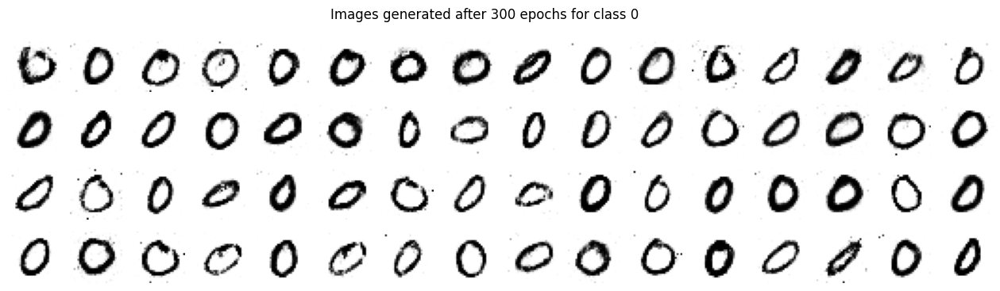

53/53 [==============================] - 1s 28ms/step - discriminator_loss: 0.6650 - generator_loss: 0.8605
Epoch 301/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6661 - generator_loss: 0.8631
Epoch 302/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6675 - generator_loss: 0.8705
Epoch 303/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6673 - generator_loss: 0.8658
Epoch 304/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6669 - generator_loss: 0.8552
Epoch 305/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6698 - generator_loss: 0.8646
Epoch 306/500
53/53 [==============================] - 1s 11ms/step - discriminator_loss: 0.6661 - generator_loss: 0.8499
Epoch 307/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6635 - generator_loss: 0.8682
Epoch 308/500
53/53 [=================

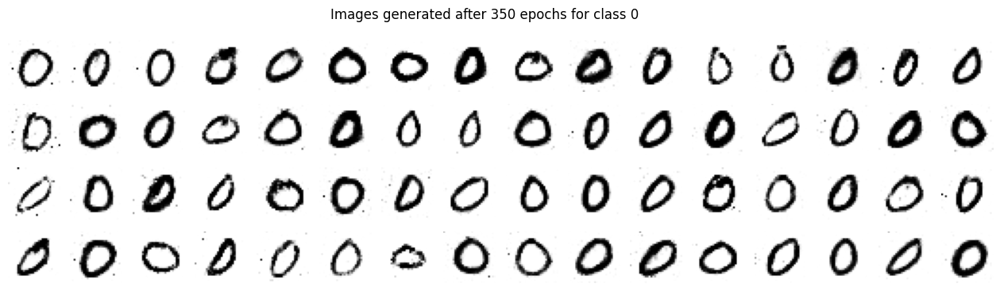

53/53 [==============================] - 1s 28ms/step - discriminator_loss: 0.6553 - generator_loss: 0.8972
Epoch 351/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6575 - generator_loss: 0.8889
Epoch 352/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6532 - generator_loss: 0.8894
Epoch 353/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6532 - generator_loss: 0.8849
Epoch 354/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6568 - generator_loss: 0.8809
Epoch 355/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6529 - generator_loss: 0.8836
Epoch 356/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6504 - generator_loss: 0.8963
Epoch 357/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6544 - generator_loss: 0.8881
Epoch 358/500
53/53 [=================

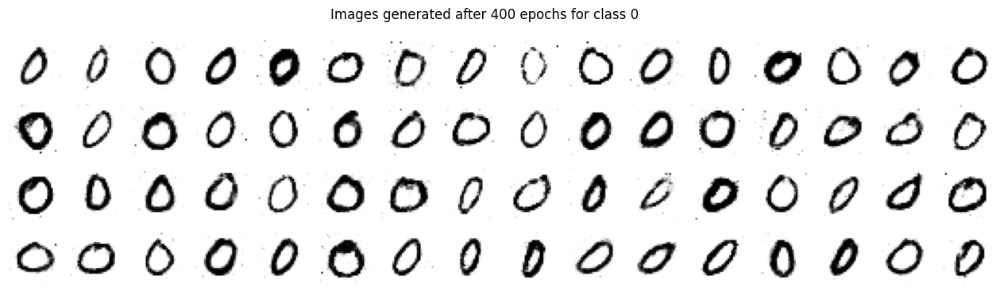

53/53 [==============================] - 1s 28ms/step - discriminator_loss: 0.6434 - generator_loss: 0.9233
Epoch 401/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6411 - generator_loss: 0.9166
Epoch 402/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6410 - generator_loss: 0.9159
Epoch 403/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6412 - generator_loss: 0.9094
Epoch 404/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6375 - generator_loss: 0.9052
Epoch 405/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6393 - generator_loss: 0.9136
Epoch 406/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6431 - generator_loss: 0.9078
Epoch 407/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6343 - generator_loss: 0.9051
Epoch 408/500
53/53 [=================

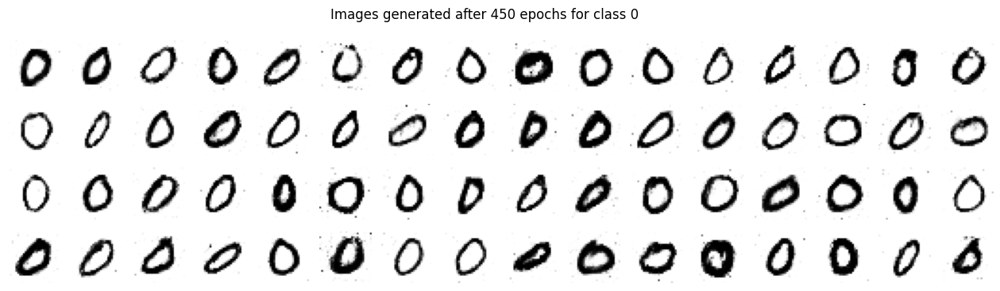

53/53 [==============================] - 1s 28ms/step - discriminator_loss: 0.6165 - generator_loss: 0.9470
Epoch 451/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6184 - generator_loss: 0.9341
Epoch 452/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6214 - generator_loss: 0.9584
Epoch 453/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6181 - generator_loss: 0.9587
Epoch 454/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6175 - generator_loss: 0.9576
Epoch 455/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6187 - generator_loss: 0.9435
Epoch 456/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6168 - generator_loss: 0.9495
Epoch 457/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6170 - generator_loss: 0.9650
Epoch 458/500
53/53 [=================

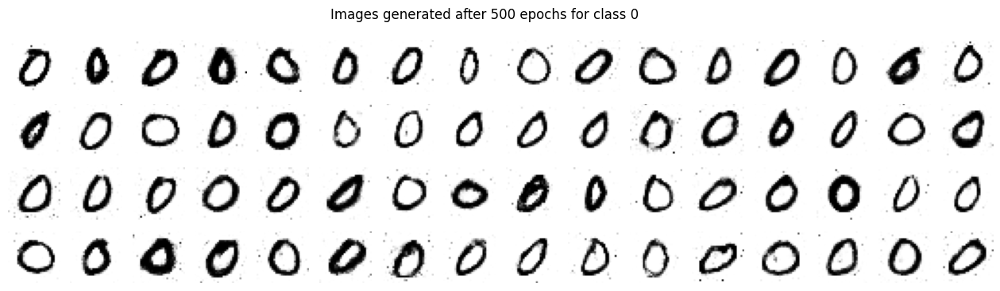

53/53 [==============================] - 1s 28ms/step - discriminator_loss: 0.5902 - generator_loss: 1.0086
Epoch 1/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6259 - generator_loss: 0.7739
Epoch 2/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.5670 - generator_loss: 0.8582
Epoch 3/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6887 - generator_loss: 0.9579
Epoch 4/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.7094 - generator_loss: 0.9533
Epoch 5/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6562 - generator_loss: 0.9550
Epoch 6/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.5389 - generator_loss: 1.0560
Epoch 7/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6607 - generator_loss: 0.9039
Epoch 8/500
61/61 [==============================] -

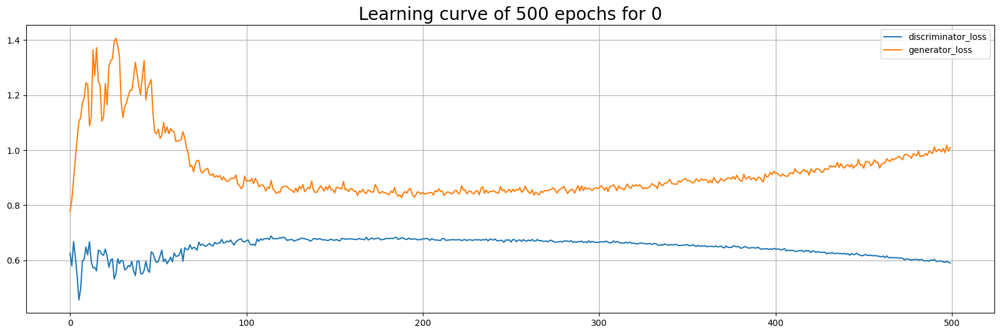

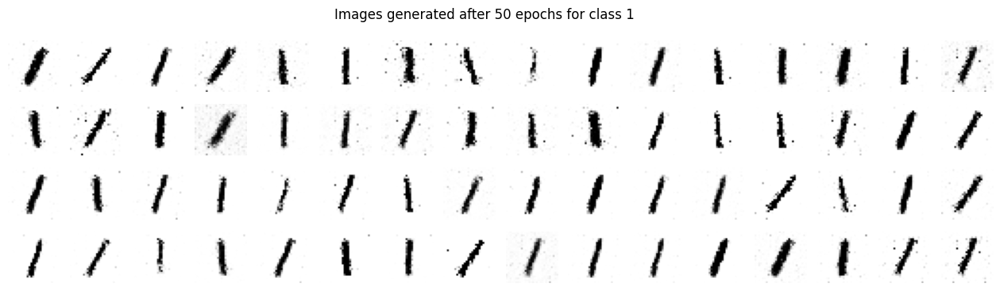

61/61 [==============================] - 2s 29ms/step - discriminator_loss: 0.6846 - generator_loss: 0.8102
Epoch 51/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6878 - generator_loss: 0.8194
Epoch 52/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6817 - generator_loss: 0.8080
Epoch 53/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6938 - generator_loss: 0.8246
Epoch 54/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6859 - generator_loss: 0.8101
Epoch 55/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6901 - generator_loss: 0.8114
Epoch 56/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6873 - generator_loss: 0.8111
Epoch 57/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6831 - generator_loss: 0.8069
Epoch 58/500
61/61 [=========================

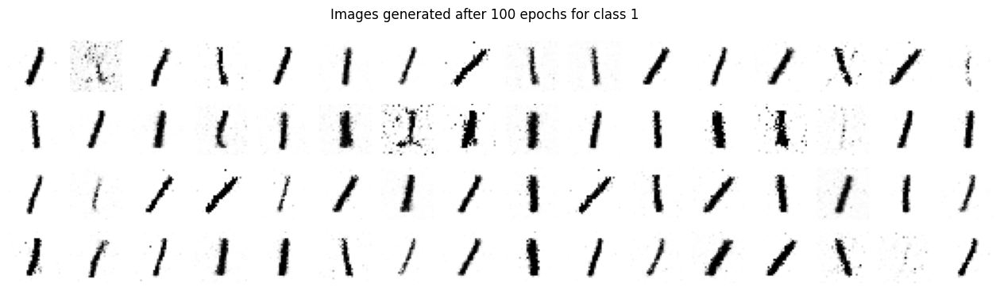

61/61 [==============================] - 2s 27ms/step - discriminator_loss: 0.6878 - generator_loss: 0.7789
Epoch 101/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6960 - generator_loss: 0.7910
Epoch 102/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6910 - generator_loss: 0.7996
Epoch 103/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6861 - generator_loss: 0.7875
Epoch 104/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6901 - generator_loss: 0.7930
Epoch 105/500
61/61 [==============================] - 1s 11ms/step - discriminator_loss: 0.6907 - generator_loss: 0.7915
Epoch 106/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6904 - generator_loss: 0.7823
Epoch 107/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6927 - generator_loss: 0.7894
Epoch 108/500
61/61 [=================

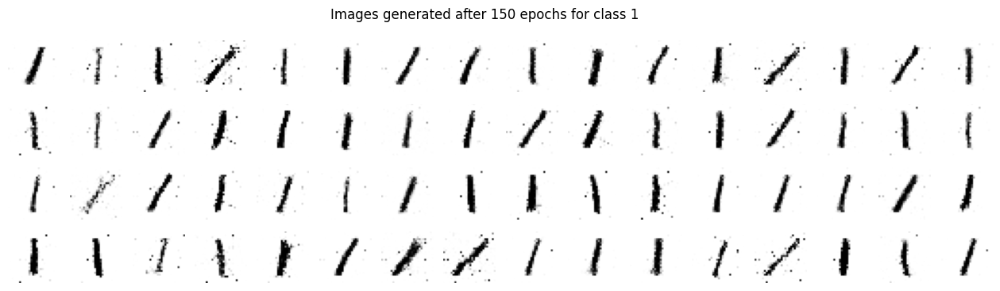

61/61 [==============================] - 2s 26ms/step - discriminator_loss: 0.6887 - generator_loss: 0.7840
Epoch 151/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6899 - generator_loss: 0.7875
Epoch 152/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6916 - generator_loss: 0.7810
Epoch 153/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6883 - generator_loss: 0.7845
Epoch 154/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6909 - generator_loss: 0.7852
Epoch 155/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6927 - generator_loss: 0.7876
Epoch 156/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6925 - generator_loss: 0.7830
Epoch 157/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6915 - generator_loss: 0.7816
Epoch 158/500
61/61 [=================

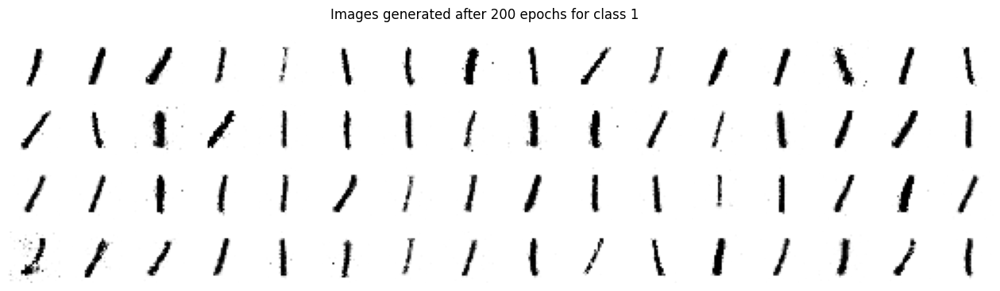

61/61 [==============================] - 2s 26ms/step - discriminator_loss: 0.6910 - generator_loss: 0.7779
Epoch 201/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6943 - generator_loss: 0.7823
Epoch 202/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6948 - generator_loss: 0.7885
Epoch 203/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6902 - generator_loss: 0.7764
Epoch 204/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6926 - generator_loss: 0.7758
Epoch 205/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6916 - generator_loss: 0.7683
Epoch 206/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6925 - generator_loss: 0.7744
Epoch 207/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6929 - generator_loss: 0.7771
Epoch 208/500
61/61 [=================

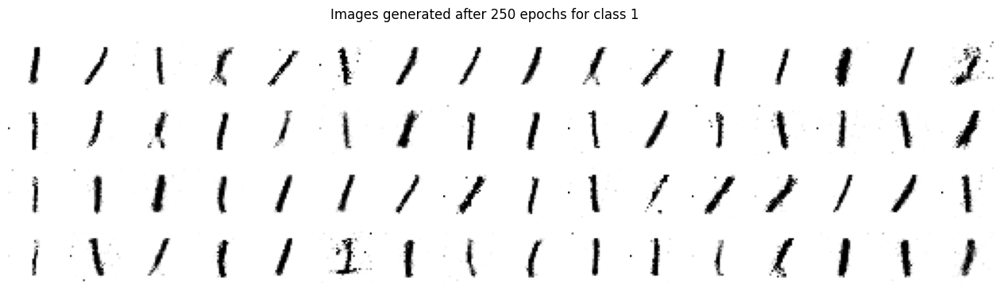

61/61 [==============================] - 2s 26ms/step - discriminator_loss: 0.6913 - generator_loss: 0.7761
Epoch 251/500
61/61 [==============================] - 1s 13ms/step - discriminator_loss: 0.6905 - generator_loss: 0.7770
Epoch 252/500
61/61 [==============================] - 1s 13ms/step - discriminator_loss: 0.6910 - generator_loss: 0.7789
Epoch 253/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6911 - generator_loss: 0.7788
Epoch 254/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6900 - generator_loss: 0.7863
Epoch 255/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6914 - generator_loss: 0.7746
Epoch 256/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6894 - generator_loss: 0.7741
Epoch 257/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6897 - generator_loss: 0.7704
Epoch 258/500
61/61 [=================

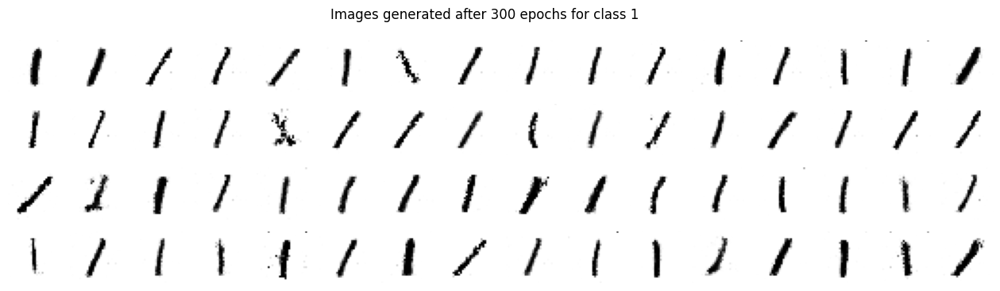

61/61 [==============================] - 2s 25ms/step - discriminator_loss: 0.6911 - generator_loss: 0.7693
Epoch 301/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6913 - generator_loss: 0.7680
Epoch 302/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6916 - generator_loss: 0.7719
Epoch 303/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6931 - generator_loss: 0.7706
Epoch 304/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6924 - generator_loss: 0.7758
Epoch 305/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6917 - generator_loss: 0.7694
Epoch 306/500
61/61 [==============================] - 1s 11ms/step - discriminator_loss: 0.6915 - generator_loss: 0.7700
Epoch 307/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6924 - generator_loss: 0.7664
Epoch 308/500
61/61 [=================

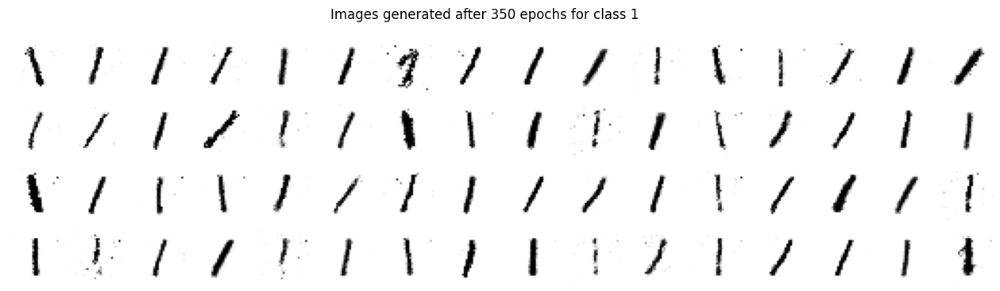

61/61 [==============================] - 2s 25ms/step - discriminator_loss: 0.6931 - generator_loss: 0.7742
Epoch 351/500
61/61 [==============================] - 1s 11ms/step - discriminator_loss: 0.6912 - generator_loss: 0.7716
Epoch 352/500
61/61 [==============================] - 1s 11ms/step - discriminator_loss: 0.6925 - generator_loss: 0.7745
Epoch 353/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6924 - generator_loss: 0.7813
Epoch 354/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6910 - generator_loss: 0.7761
Epoch 355/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6878 - generator_loss: 0.7668
Epoch 356/500
61/61 [==============================] - 1s 11ms/step - discriminator_loss: 0.6908 - generator_loss: 0.7700
Epoch 357/500
61/61 [==============================] - 1s 11ms/step - discriminator_loss: 0.6928 - generator_loss: 0.7754
Epoch 358/500
61/61 [=================

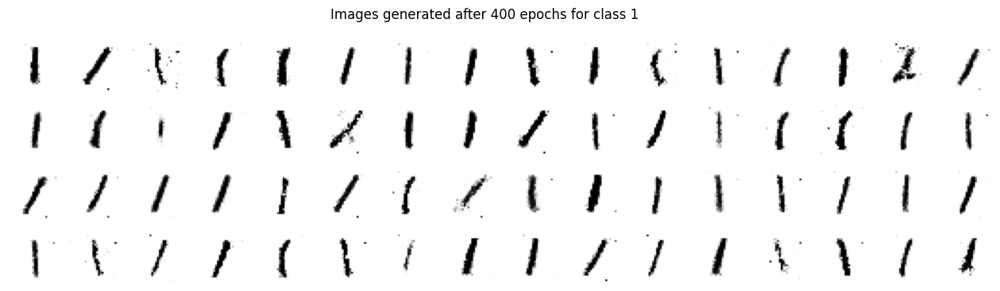

61/61 [==============================] - 2s 25ms/step - discriminator_loss: 0.6917 - generator_loss: 0.7678
Epoch 401/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6909 - generator_loss: 0.7723
Epoch 402/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6853 - generator_loss: 0.7777
Epoch 403/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6895 - generator_loss: 0.7690
Epoch 404/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6926 - generator_loss: 0.7717
Epoch 405/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6880 - generator_loss: 0.7628
Epoch 406/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6889 - generator_loss: 0.7681
Epoch 407/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6891 - generator_loss: 0.7626
Epoch 408/500
61/61 [=================

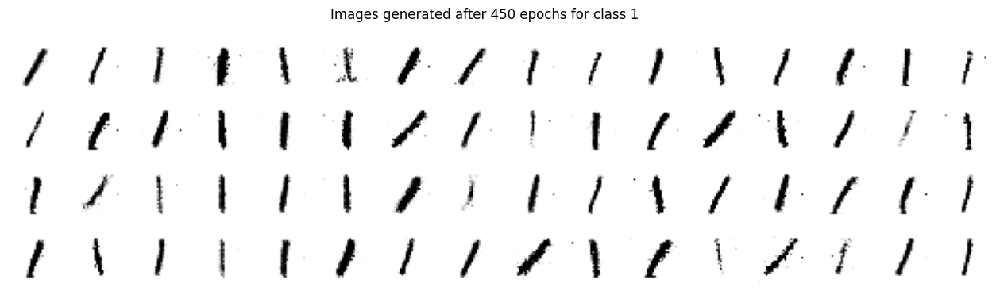

61/61 [==============================] - 2s 25ms/step - discriminator_loss: 0.6867 - generator_loss: 0.7718
Epoch 451/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6881 - generator_loss: 0.7732
Epoch 452/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6910 - generator_loss: 0.7700
Epoch 453/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6874 - generator_loss: 0.7699
Epoch 454/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6896 - generator_loss: 0.7642
Epoch 455/500
61/61 [==============================] - 1s 12ms/step - discriminator_loss: 0.6891 - generator_loss: 0.7667
Epoch 456/500
61/61 [==============================] - 1s 11ms/step - discriminator_loss: 0.6889 - generator_loss: 0.7663
Epoch 457/500
61/61 [==============================] - 1s 11ms/step - discriminator_loss: 0.6911 - generator_loss: 0.7714
Epoch 458/500
61/61 [=================

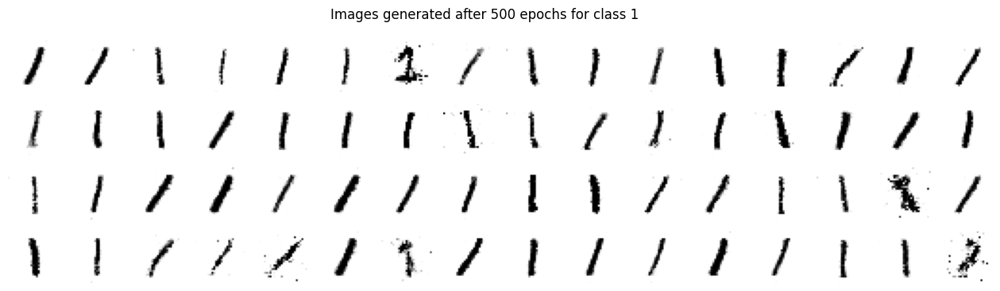

61/61 [==============================] - 2s 25ms/step - discriminator_loss: 0.6915 - generator_loss: 0.7626
Epoch 1/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6019 - generator_loss: 0.7617
Epoch 2/500
54/54 [==============================] - 1s 11ms/step - discriminator_loss: 0.5859 - generator_loss: 0.8311
Epoch 3/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.7057 - generator_loss: 0.9226
Epoch 4/500
54/54 [==============================] - 1s 11ms/step - discriminator_loss: 0.6645 - generator_loss: 0.9115
Epoch 5/500
54/54 [==============================] - 1s 11ms/step - discriminator_loss: 0.6303 - generator_loss: 0.9620
Epoch 6/500
54/54 [==============================] - 1s 11ms/step - discriminator_loss: 0.5840 - generator_loss: 1.0392
Epoch 7/500
54/54 [==============================] - 1s 11ms/step - discriminator_loss: 0.5370 - generator_loss: 1.0791
Epoch 8/500
54/54 [==============================] -

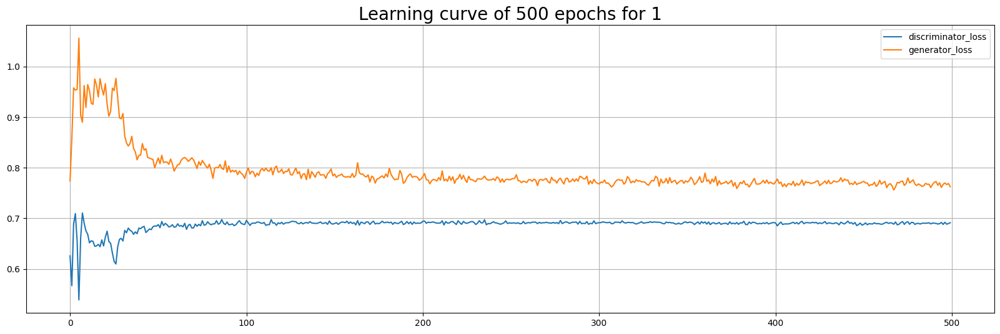

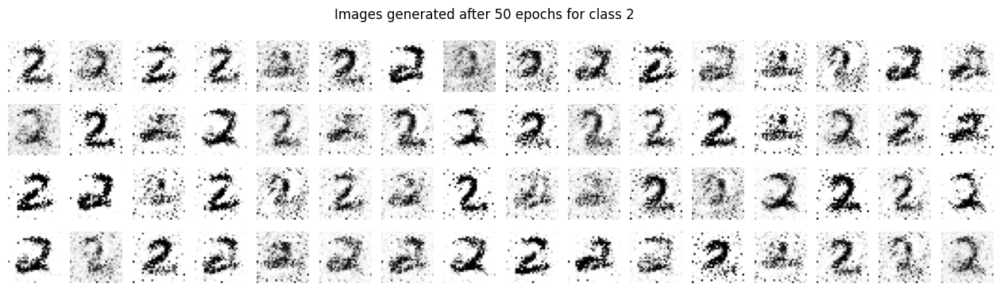

54/54 [==============================] - 2s 31ms/step - discriminator_loss: 0.5196 - generator_loss: 1.4890
Epoch 51/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5779 - generator_loss: 1.4938
Epoch 52/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.4962 - generator_loss: 1.5186
Epoch 53/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5529 - generator_loss: 1.6432
Epoch 54/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5349 - generator_loss: 1.6872
Epoch 55/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5189 - generator_loss: 1.5263
Epoch 56/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5534 - generator_loss: 1.7303
Epoch 57/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5604 - generator_loss: 1.6151
Epoch 58/500
54/54 [=========================

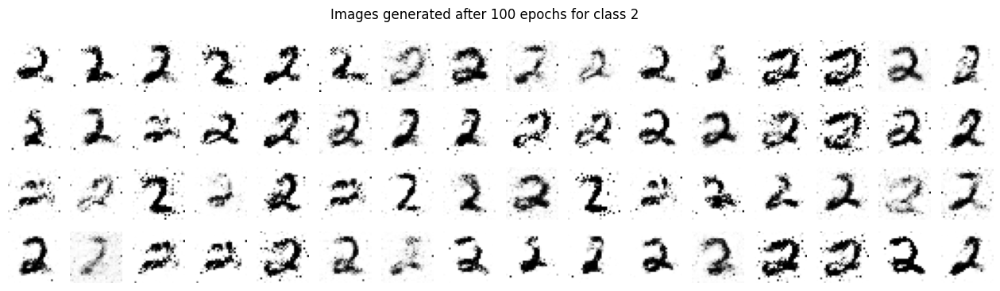

54/54 [==============================] - 1s 28ms/step - discriminator_loss: 0.5836 - generator_loss: 1.1384
Epoch 101/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5771 - generator_loss: 1.1305
Epoch 102/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5894 - generator_loss: 1.1435
Epoch 103/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5776 - generator_loss: 1.1312
Epoch 104/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5893 - generator_loss: 1.1321
Epoch 105/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6001 - generator_loss: 1.1161
Epoch 106/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5954 - generator_loss: 1.1488
Epoch 107/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5793 - generator_loss: 1.1579
Epoch 108/500
54/54 [=================

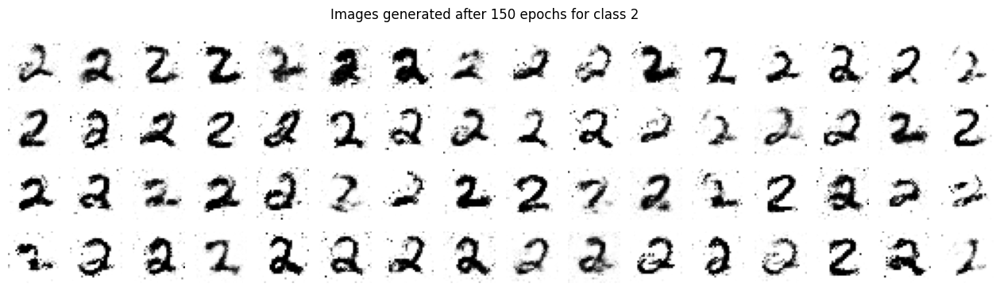

54/54 [==============================] - 2s 30ms/step - discriminator_loss: 0.6320 - generator_loss: 1.0274
Epoch 151/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6147 - generator_loss: 1.0231
Epoch 152/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6367 - generator_loss: 1.0178
Epoch 153/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6419 - generator_loss: 0.9975
Epoch 154/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6428 - generator_loss: 0.9889
Epoch 155/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6225 - generator_loss: 1.0126
Epoch 156/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6300 - generator_loss: 1.0099
Epoch 157/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6263 - generator_loss: 1.0285
Epoch 158/500
54/54 [=================

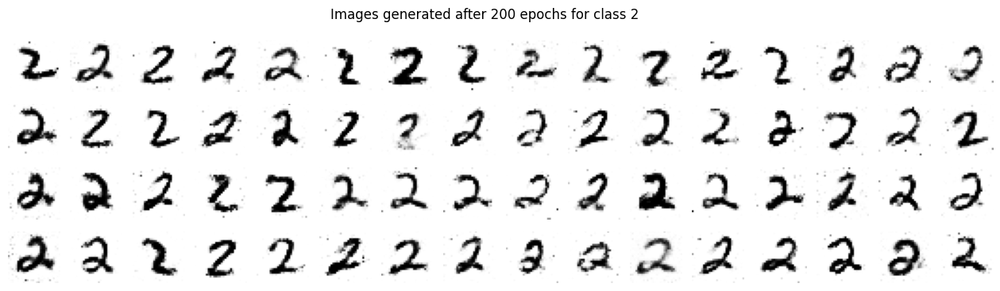

54/54 [==============================] - 1s 28ms/step - discriminator_loss: 0.6324 - generator_loss: 1.0142
Epoch 201/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6291 - generator_loss: 0.9876
Epoch 202/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6270 - generator_loss: 1.0069
Epoch 203/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6238 - generator_loss: 1.0050
Epoch 204/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6272 - generator_loss: 1.0059
Epoch 205/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6223 - generator_loss: 1.0227
Epoch 206/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6278 - generator_loss: 1.0084
Epoch 207/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6201 - generator_loss: 0.9910
Epoch 208/500
54/54 [=================

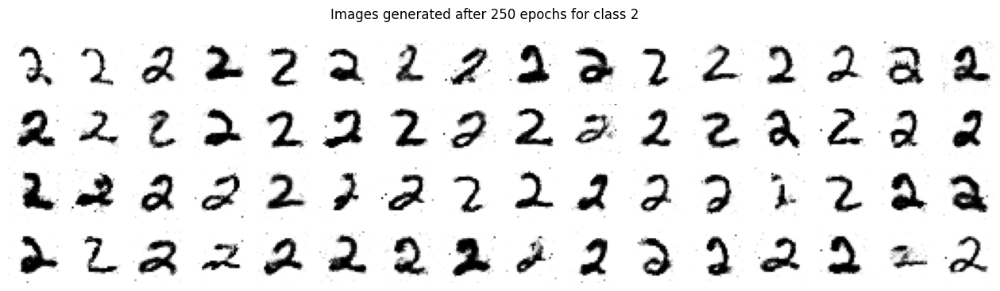

54/54 [==============================] - 1s 28ms/step - discriminator_loss: 0.6249 - generator_loss: 1.0071
Epoch 251/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6256 - generator_loss: 1.0255
Epoch 252/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6283 - generator_loss: 0.9887
Epoch 253/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6284 - generator_loss: 0.9910
Epoch 254/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6241 - generator_loss: 0.9847
Epoch 255/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6227 - generator_loss: 0.9878
Epoch 256/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6258 - generator_loss: 0.9865
Epoch 257/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6318 - generator_loss: 0.9934
Epoch 258/500
54/54 [=================

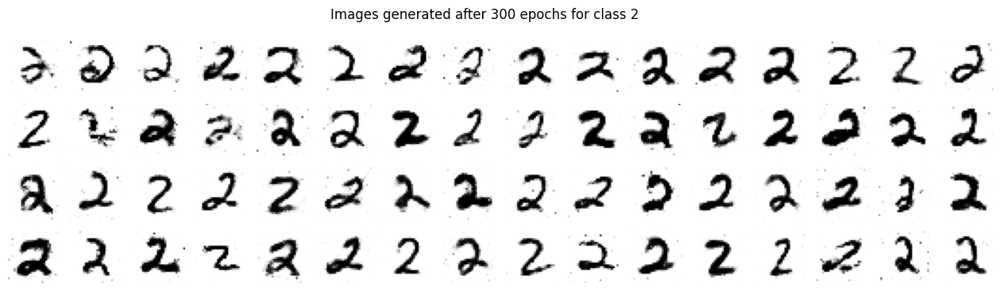

54/54 [==============================] - 1s 28ms/step - discriminator_loss: 0.6051 - generator_loss: 1.0207
Epoch 301/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6104 - generator_loss: 1.0199
Epoch 302/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6093 - generator_loss: 1.0134
Epoch 303/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6032 - generator_loss: 1.0132
Epoch 304/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6044 - generator_loss: 1.0204
Epoch 305/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6054 - generator_loss: 1.0264
Epoch 306/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6056 - generator_loss: 1.0348
Epoch 307/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6029 - generator_loss: 1.0227
Epoch 308/500
54/54 [=================

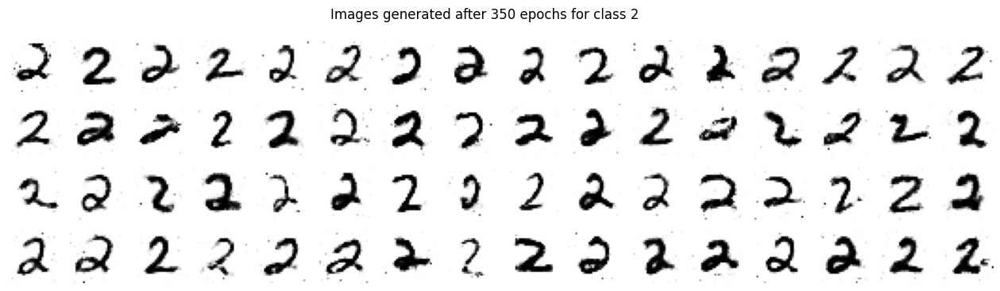

54/54 [==============================] - 1s 27ms/step - discriminator_loss: 0.5740 - generator_loss: 1.0791
Epoch 351/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5749 - generator_loss: 1.0947
Epoch 352/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5792 - generator_loss: 1.0985
Epoch 353/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5699 - generator_loss: 1.0816
Epoch 354/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5707 - generator_loss: 1.0794
Epoch 355/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5695 - generator_loss: 1.0783
Epoch 356/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5691 - generator_loss: 1.0890
Epoch 357/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5755 - generator_loss: 1.1032
Epoch 358/500
54/54 [=================

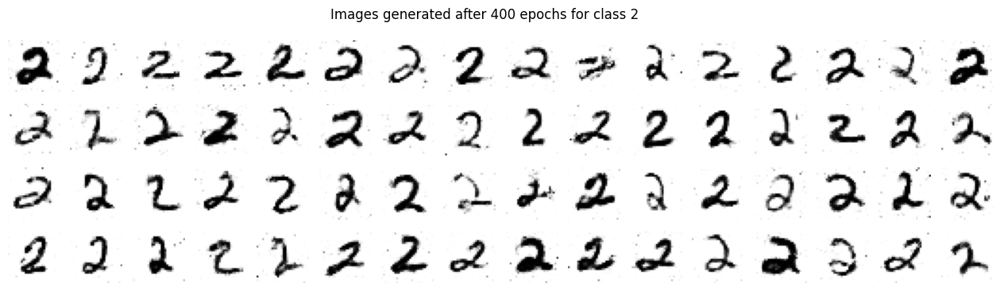

54/54 [==============================] - 2s 28ms/step - discriminator_loss: 0.5330 - generator_loss: 1.1602
Epoch 401/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5536 - generator_loss: 1.1826
Epoch 402/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5371 - generator_loss: 1.1613
Epoch 403/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5382 - generator_loss: 1.1701
Epoch 404/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5390 - generator_loss: 1.1590
Epoch 405/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5365 - generator_loss: 1.1727
Epoch 406/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5434 - generator_loss: 1.1601
Epoch 407/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5394 - generator_loss: 1.1703
Epoch 408/500
54/54 [=================

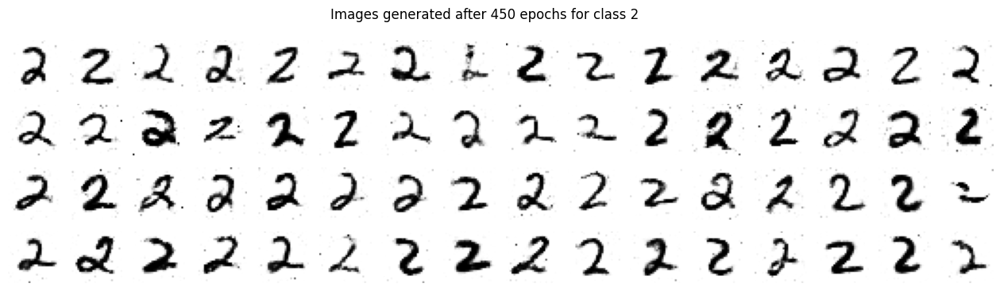

54/54 [==============================] - 1s 27ms/step - discriminator_loss: 0.5115 - generator_loss: 1.2418
Epoch 451/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5124 - generator_loss: 1.2580
Epoch 452/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5105 - generator_loss: 1.2367
Epoch 453/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5041 - generator_loss: 1.2543
Epoch 454/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5186 - generator_loss: 1.2721
Epoch 455/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5103 - generator_loss: 1.2640
Epoch 456/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5036 - generator_loss: 1.2518
Epoch 457/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5083 - generator_loss: 1.2569
Epoch 458/500
54/54 [=================

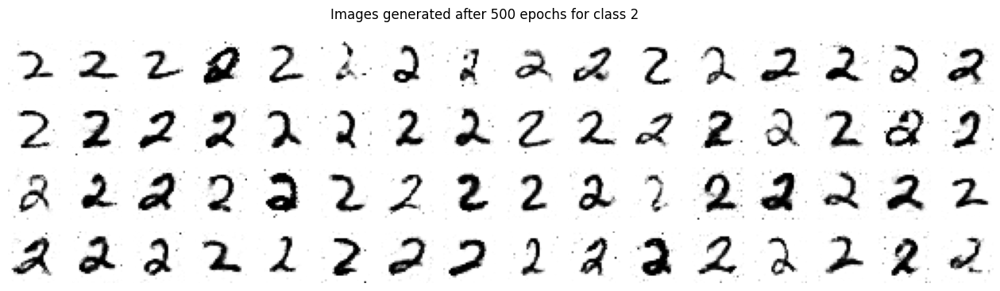

54/54 [==============================] - 2s 29ms/step - discriminator_loss: 0.4908 - generator_loss: 1.3414
Epoch 1/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6107 - generator_loss: 0.7730
Epoch 2/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.5729 - generator_loss: 0.8481
Epoch 3/500
55/55 [==============================] - 1s 11ms/step - discriminator_loss: 0.7113 - generator_loss: 0.9168
Epoch 4/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.7087 - generator_loss: 0.9234
Epoch 5/500
55/55 [==============================] - 1s 11ms/step - discriminator_loss: 0.7156 - generator_loss: 0.9470
Epoch 6/500
55/55 [==============================] - 1s 11ms/step - discriminator_loss: 0.6290 - generator_loss: 1.0305
Epoch 7/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.5685 - generator_loss: 1.0719
Epoch 8/500
55/55 [==============================] -

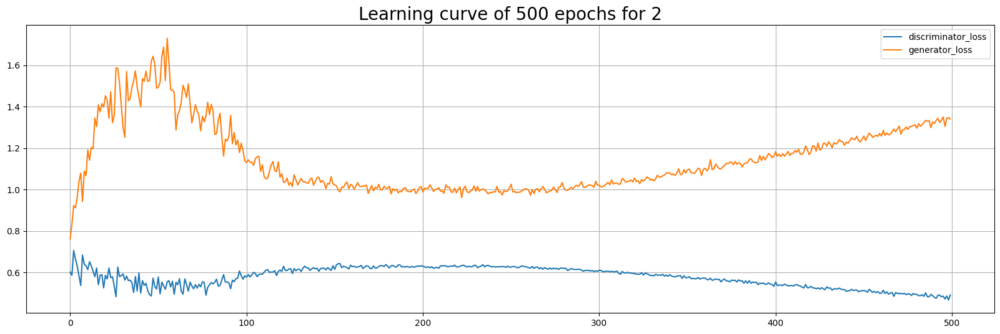

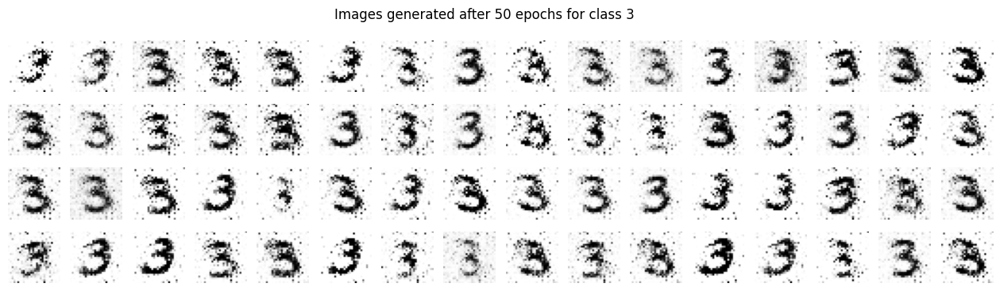

55/55 [==============================] - 2s 30ms/step - discriminator_loss: 0.5631 - generator_loss: 1.3912
Epoch 51/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.5662 - generator_loss: 1.2784
Epoch 52/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6116 - generator_loss: 1.3145
Epoch 53/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.5607 - generator_loss: 1.2462
Epoch 54/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.5543 - generator_loss: 1.2448
Epoch 55/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.5857 - generator_loss: 1.2558
Epoch 56/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.5726 - generator_loss: 1.2721
Epoch 57/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.5594 - generator_loss: 1.2619
Epoch 58/500
55/55 [=========================

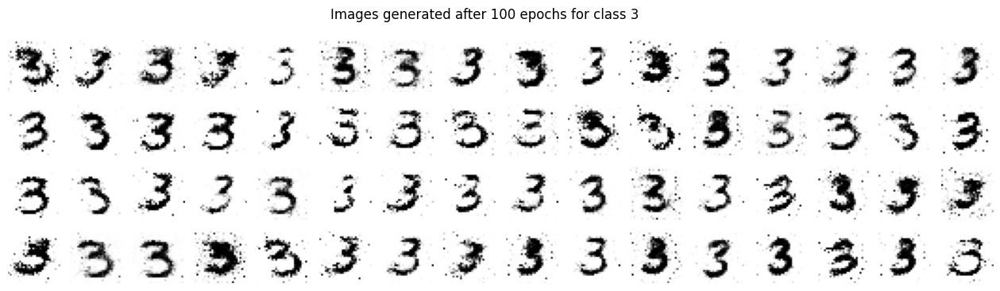

55/55 [==============================] - 2s 28ms/step - discriminator_loss: 0.6041 - generator_loss: 1.0850
Epoch 101/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6157 - generator_loss: 1.0766
Epoch 102/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6292 - generator_loss: 1.0419
Epoch 103/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6354 - generator_loss: 0.9959
Epoch 104/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6250 - generator_loss: 1.0184
Epoch 105/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6444 - generator_loss: 0.9789
Epoch 106/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6234 - generator_loss: 0.9722
Epoch 107/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6222 - generator_loss: 1.0032
Epoch 108/500
55/55 [=================

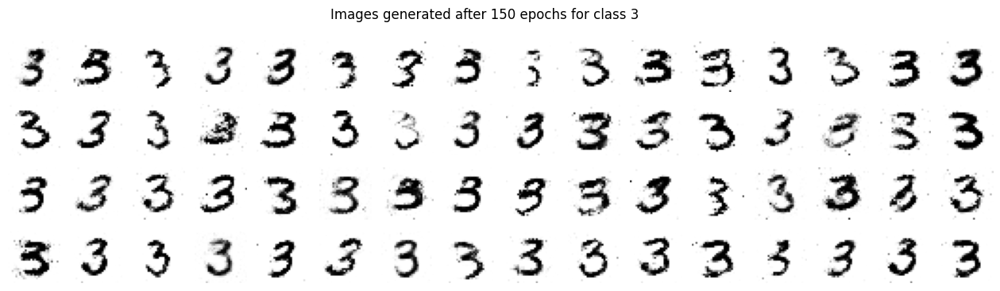

55/55 [==============================] - 1s 27ms/step - discriminator_loss: 0.6636 - generator_loss: 0.8968
Epoch 151/500
55/55 [==============================] - 1s 11ms/step - discriminator_loss: 0.6596 - generator_loss: 0.8946
Epoch 152/500
55/55 [==============================] - 1s 11ms/step - discriminator_loss: 0.6578 - generator_loss: 0.9061
Epoch 153/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6598 - generator_loss: 0.9276
Epoch 154/500
55/55 [==============================] - 1s 11ms/step - discriminator_loss: 0.6640 - generator_loss: 0.9180
Epoch 155/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6568 - generator_loss: 0.9001
Epoch 156/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6557 - generator_loss: 0.9091
Epoch 157/500
55/55 [==============================] - 1s 11ms/step - discriminator_loss: 0.6636 - generator_loss: 0.8992
Epoch 158/500
55/55 [=================

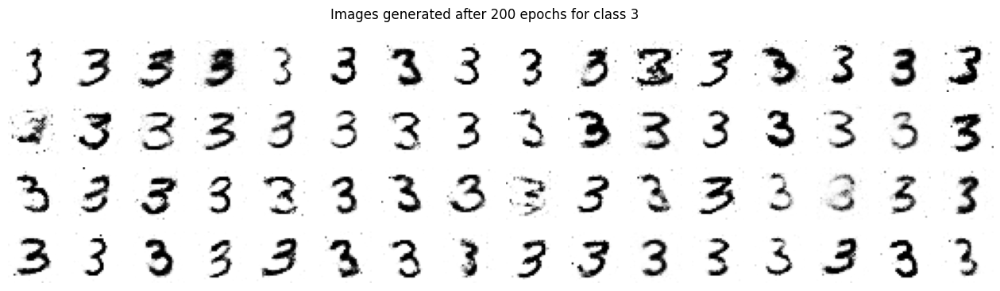

55/55 [==============================] - 2s 29ms/step - discriminator_loss: 0.6507 - generator_loss: 0.9107
Epoch 201/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6540 - generator_loss: 0.9291
Epoch 202/500
55/55 [==============================] - 1s 11ms/step - discriminator_loss: 0.6554 - generator_loss: 0.9224
Epoch 203/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6530 - generator_loss: 0.9272
Epoch 204/500
55/55 [==============================] - 1s 11ms/step - discriminator_loss: 0.6543 - generator_loss: 0.9185
Epoch 205/500
55/55 [==============================] - 1s 11ms/step - discriminator_loss: 0.6486 - generator_loss: 0.9397
Epoch 206/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6535 - generator_loss: 0.9222
Epoch 207/500
55/55 [==============================] - 1s 11ms/step - discriminator_loss: 0.6496 - generator_loss: 0.9373
Epoch 208/500
55/55 [=================

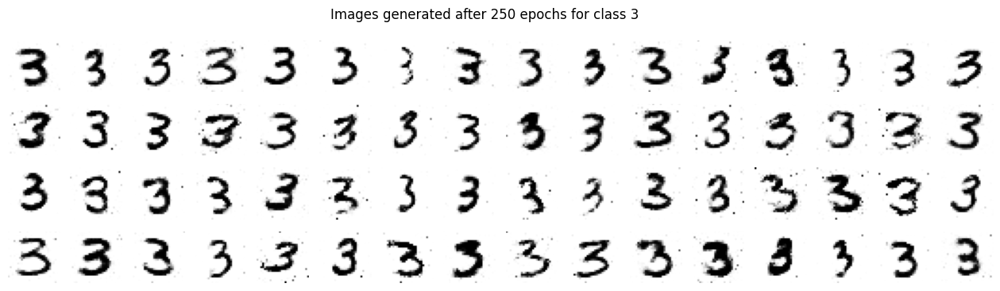

55/55 [==============================] - 1s 27ms/step - discriminator_loss: 0.6409 - generator_loss: 0.9202
Epoch 251/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6449 - generator_loss: 0.9304
Epoch 252/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6439 - generator_loss: 0.9312
Epoch 253/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6445 - generator_loss: 0.9267
Epoch 254/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6433 - generator_loss: 0.9270
Epoch 255/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6420 - generator_loss: 0.9431
Epoch 256/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6445 - generator_loss: 0.9436
Epoch 257/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6432 - generator_loss: 0.9364
Epoch 258/500
55/55 [=================

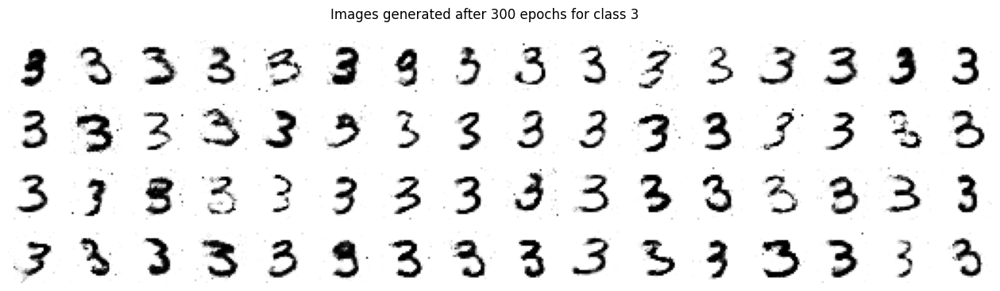

55/55 [==============================] - 1s 27ms/step - discriminator_loss: 0.6285 - generator_loss: 0.9617
Epoch 301/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6301 - generator_loss: 0.9889
Epoch 302/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6296 - generator_loss: 0.9858
Epoch 303/500
55/55 [==============================] - 1s 11ms/step - discriminator_loss: 0.6239 - generator_loss: 0.9452
Epoch 304/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6214 - generator_loss: 0.9461
Epoch 305/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6268 - generator_loss: 0.9805
Epoch 306/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6269 - generator_loss: 0.9643
Epoch 307/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6210 - generator_loss: 0.9544
Epoch 308/500
55/55 [=================

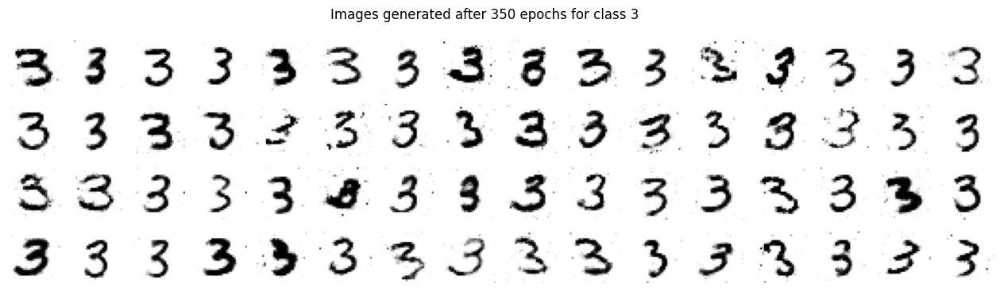

55/55 [==============================] - 2s 28ms/step - discriminator_loss: 0.6045 - generator_loss: 0.9968
Epoch 351/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6032 - generator_loss: 0.9929
Epoch 352/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6029 - generator_loss: 1.0066
Epoch 353/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6022 - generator_loss: 1.0186
Epoch 354/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6065 - generator_loss: 1.0129
Epoch 355/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6016 - generator_loss: 1.0201
Epoch 356/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6002 - generator_loss: 1.0067
Epoch 357/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.6043 - generator_loss: 1.0218
Epoch 358/500
55/55 [=================

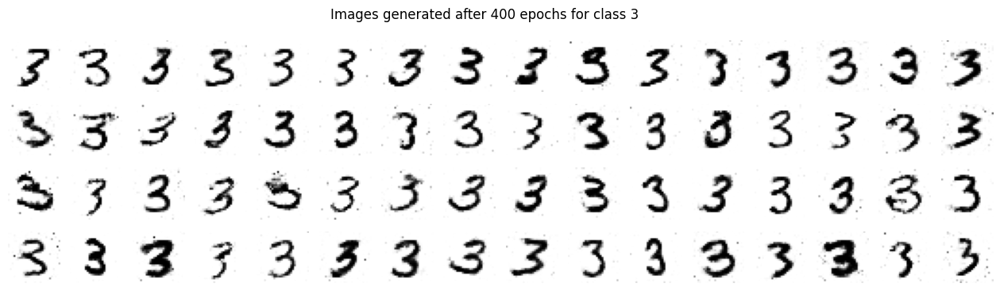

55/55 [==============================] - 1s 27ms/step - discriminator_loss: 0.5700 - generator_loss: 1.0779
Epoch 401/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.5684 - generator_loss: 1.0815
Epoch 402/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.5723 - generator_loss: 1.0944
Epoch 403/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.5694 - generator_loss: 1.0855
Epoch 404/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.5681 - generator_loss: 1.0690
Epoch 405/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.5622 - generator_loss: 1.0815
Epoch 406/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.5670 - generator_loss: 1.0999
Epoch 407/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.5641 - generator_loss: 1.0790
Epoch 408/500
55/55 [=================

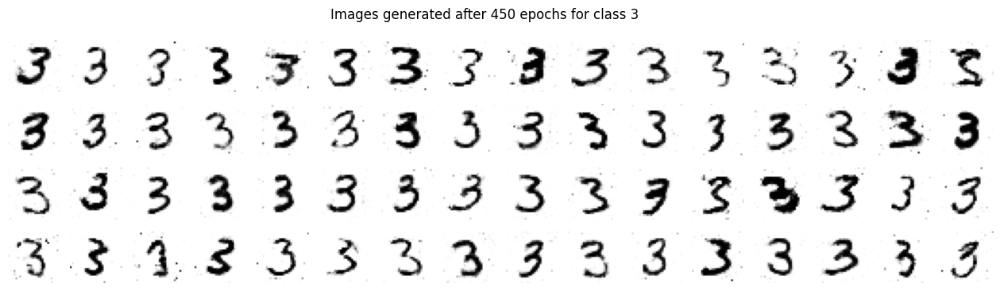

55/55 [==============================] - 1s 27ms/step - discriminator_loss: 0.5361 - generator_loss: 1.1579
Epoch 451/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.5283 - generator_loss: 1.1611
Epoch 452/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.5393 - generator_loss: 1.1574
Epoch 453/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.5335 - generator_loss: 1.1704
Epoch 454/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.5283 - generator_loss: 1.1622
Epoch 455/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.5277 - generator_loss: 1.1665
Epoch 456/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.5343 - generator_loss: 1.1692
Epoch 457/500
55/55 [==============================] - 1s 12ms/step - discriminator_loss: 0.5285 - generator_loss: 1.1794
Epoch 458/500
55/55 [=================

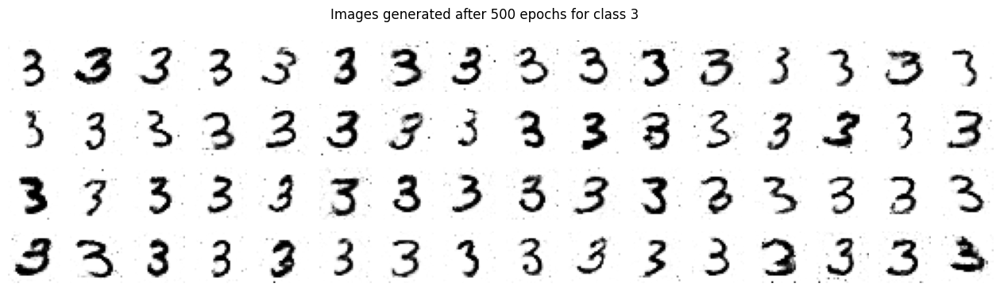

55/55 [==============================] - 2s 28ms/step - discriminator_loss: 0.4941 - generator_loss: 1.2602
Epoch 1/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.5725 - generator_loss: 0.7646
Epoch 2/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.5415 - generator_loss: 0.8418
Epoch 3/500
53/53 [==============================] - 1s 11ms/step - discriminator_loss: 0.6975 - generator_loss: 0.9318
Epoch 4/500
53/53 [==============================] - 1s 11ms/step - discriminator_loss: 0.7245 - generator_loss: 0.8735
Epoch 5/500
53/53 [==============================] - 1s 11ms/step - discriminator_loss: 0.6983 - generator_loss: 0.9240
Epoch 6/500
53/53 [==============================] - 1s 11ms/step - discriminator_loss: 0.6274 - generator_loss: 0.9626
Epoch 7/500
53/53 [==============================] - 1s 11ms/step - discriminator_loss: 0.6357 - generator_loss: 0.9421
Epoch 8/500
53/53 [==============================] -

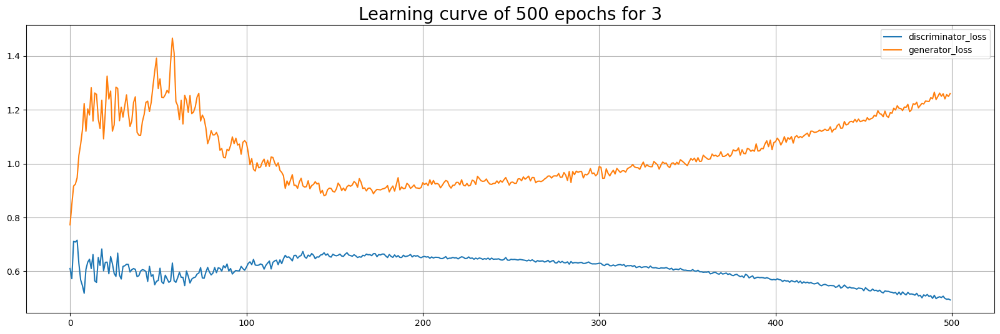

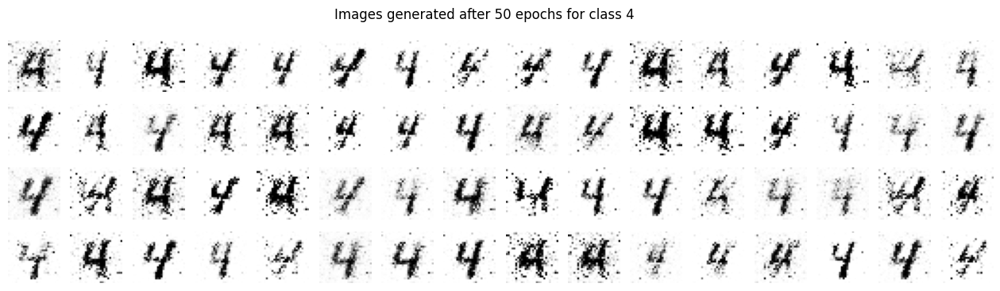

53/53 [==============================] - 2s 31ms/step - discriminator_loss: 0.6079 - generator_loss: 1.2063
Epoch 51/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5952 - generator_loss: 1.1910
Epoch 52/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5497 - generator_loss: 1.2568
Epoch 53/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.5795 - generator_loss: 1.2118
Epoch 54/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.5829 - generator_loss: 1.1851
Epoch 55/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.5949 - generator_loss: 1.2201
Epoch 56/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5845 - generator_loss: 1.2312
Epoch 57/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5901 - generator_loss: 1.2931
Epoch 58/500
53/53 [=========================

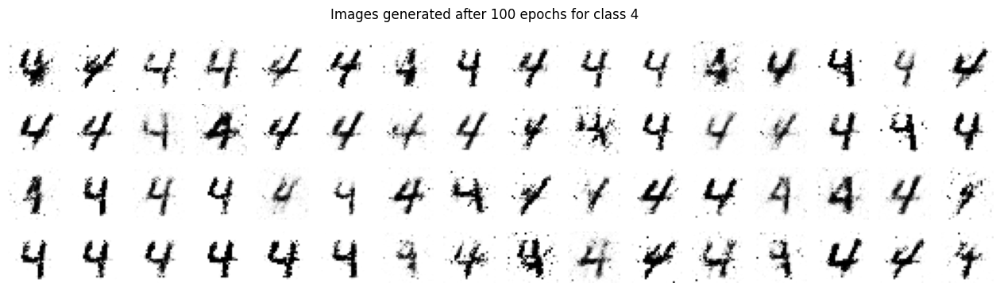

53/53 [==============================] - 2s 29ms/step - discriminator_loss: 0.6524 - generator_loss: 0.9607
Epoch 101/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6427 - generator_loss: 0.9895
Epoch 102/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6412 - generator_loss: 0.9886
Epoch 103/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6353 - generator_loss: 0.9734
Epoch 104/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6449 - generator_loss: 0.9726
Epoch 105/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6614 - generator_loss: 0.9395
Epoch 106/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6584 - generator_loss: 0.9402
Epoch 107/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6615 - generator_loss: 0.9196
Epoch 108/500
53/53 [=================

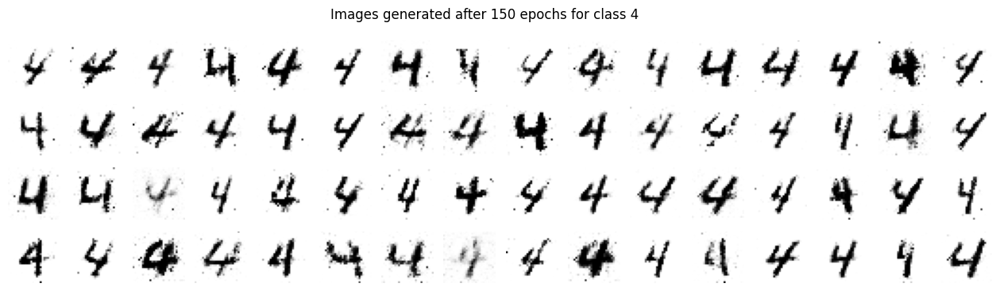

53/53 [==============================] - 1s 29ms/step - discriminator_loss: 0.6733 - generator_loss: 0.8703
Epoch 151/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6777 - generator_loss: 0.8789
Epoch 152/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6746 - generator_loss: 0.8861
Epoch 153/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6712 - generator_loss: 0.8736
Epoch 154/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6757 - generator_loss: 0.8599
Epoch 155/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6689 - generator_loss: 0.8771
Epoch 156/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6714 - generator_loss: 0.8773
Epoch 157/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6688 - generator_loss: 0.8704
Epoch 158/500
53/53 [=================

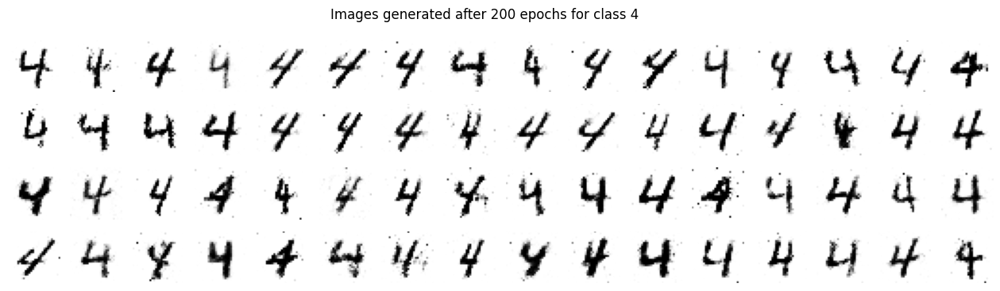

53/53 [==============================] - 1s 28ms/step - discriminator_loss: 0.6714 - generator_loss: 0.8698
Epoch 201/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6770 - generator_loss: 0.8657
Epoch 202/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6727 - generator_loss: 0.8875
Epoch 203/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6719 - generator_loss: 0.8854
Epoch 204/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6756 - generator_loss: 0.8614
Epoch 205/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6731 - generator_loss: 0.8759
Epoch 206/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6730 - generator_loss: 0.8673
Epoch 207/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6730 - generator_loss: 0.8616
Epoch 208/500
53/53 [=================

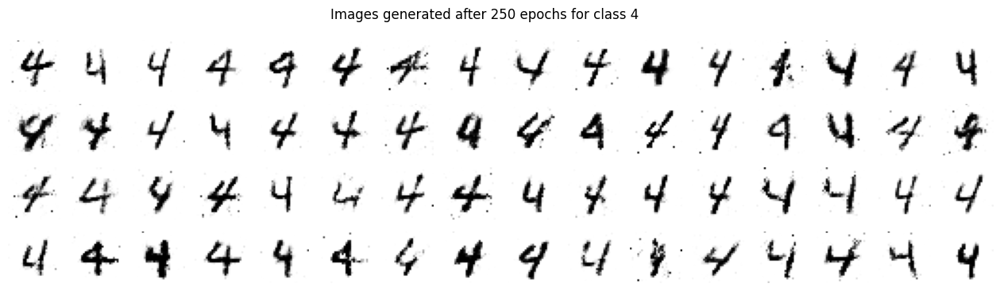

53/53 [==============================] - 2s 30ms/step - discriminator_loss: 0.6675 - generator_loss: 0.8872
Epoch 251/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6665 - generator_loss: 0.8781
Epoch 252/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6649 - generator_loss: 0.8768
Epoch 253/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6651 - generator_loss: 0.8820
Epoch 254/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6652 - generator_loss: 0.8752
Epoch 255/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6646 - generator_loss: 0.8798
Epoch 256/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6649 - generator_loss: 0.8820
Epoch 257/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6704 - generator_loss: 0.8921
Epoch 258/500
53/53 [=================

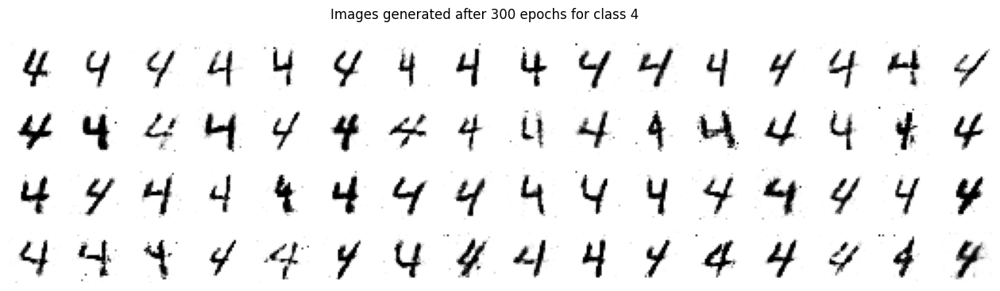

53/53 [==============================] - 1s 28ms/step - discriminator_loss: 0.6611 - generator_loss: 0.8887
Epoch 301/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6601 - generator_loss: 0.8768
Epoch 302/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6609 - generator_loss: 0.8806
Epoch 303/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6586 - generator_loss: 0.8675
Epoch 304/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6581 - generator_loss: 0.8747
Epoch 305/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6583 - generator_loss: 0.8849
Epoch 306/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6578 - generator_loss: 0.8802
Epoch 307/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6582 - generator_loss: 0.8777
Epoch 308/500
53/53 [=================

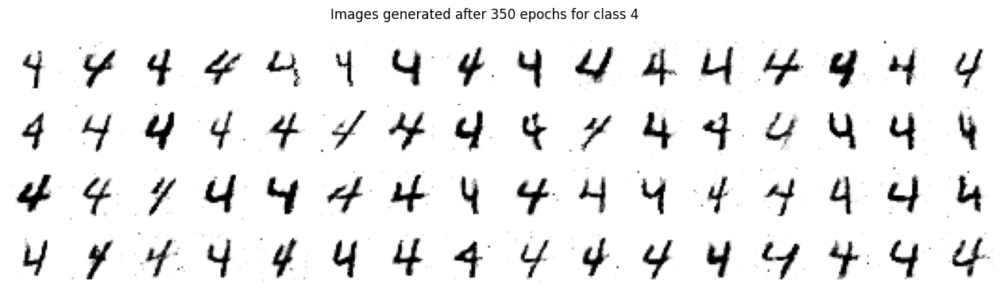

53/53 [==============================] - 2s 29ms/step - discriminator_loss: 0.6477 - generator_loss: 0.9014
Epoch 351/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6466 - generator_loss: 0.9164
Epoch 352/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6461 - generator_loss: 0.9072
Epoch 353/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6422 - generator_loss: 0.9110
Epoch 354/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6438 - generator_loss: 0.9058
Epoch 355/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6446 - generator_loss: 0.9031
Epoch 356/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6423 - generator_loss: 0.9030
Epoch 357/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6414 - generator_loss: 0.9074
Epoch 358/500
53/53 [=================

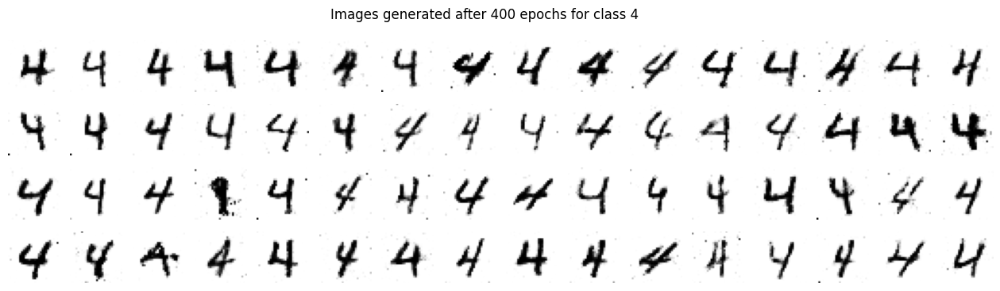

53/53 [==============================] - 1s 28ms/step - discriminator_loss: 0.6217 - generator_loss: 0.9509
Epoch 401/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6256 - generator_loss: 0.9561
Epoch 402/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6207 - generator_loss: 0.9362
Epoch 403/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6241 - generator_loss: 0.9490
Epoch 404/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6184 - generator_loss: 0.9469
Epoch 405/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6185 - generator_loss: 0.9452
Epoch 406/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6202 - generator_loss: 0.9413
Epoch 407/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6191 - generator_loss: 0.9556
Epoch 408/500
53/53 [=================

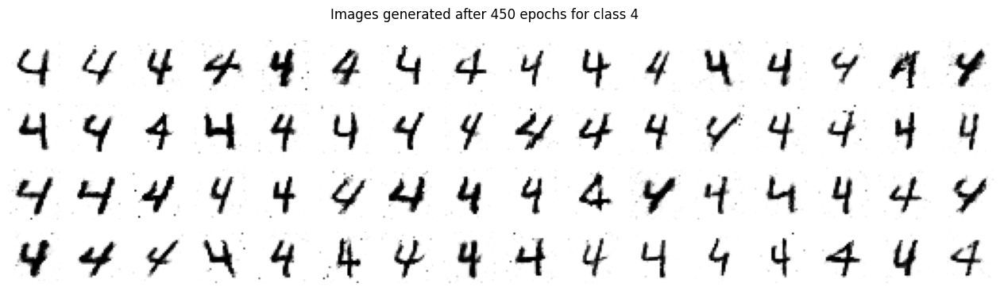

53/53 [==============================] - 2s 30ms/step - discriminator_loss: 0.5949 - generator_loss: 1.0101
Epoch 451/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5916 - generator_loss: 0.9993
Epoch 452/500
53/53 [==============================] - 1s 14ms/step - discriminator_loss: 0.5918 - generator_loss: 0.9973
Epoch 453/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5911 - generator_loss: 1.0075
Epoch 454/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5911 - generator_loss: 1.0125
Epoch 455/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5893 - generator_loss: 1.0150
Epoch 456/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5914 - generator_loss: 1.0169
Epoch 457/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5889 - generator_loss: 1.0185
Epoch 458/500
53/53 [=================

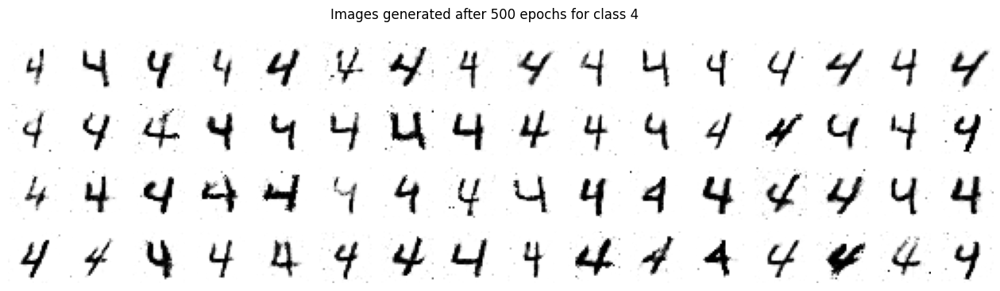

53/53 [==============================] - 2s 30ms/step - discriminator_loss: 0.5612 - generator_loss: 1.0671
Epoch 1/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.6044 - generator_loss: 0.7566
Epoch 2/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.5340 - generator_loss: 0.8403
Epoch 3/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.7046 - generator_loss: 0.9171
Epoch 4/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.7228 - generator_loss: 0.9257
Epoch 5/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.6841 - generator_loss: 0.9382
Epoch 6/500
49/49 [==============================] - 1s 12ms/step - discriminator_loss: 0.6182 - generator_loss: 1.0080
Epoch 7/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.5880 - generator_loss: 1.0649
Epoch 8/500
49/49 [==============================] -

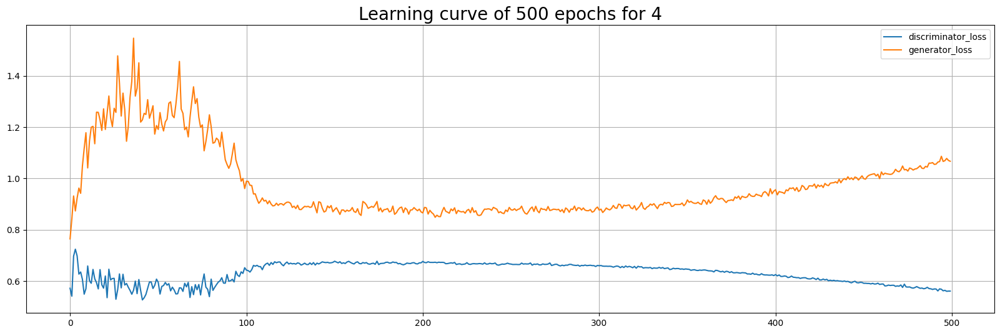

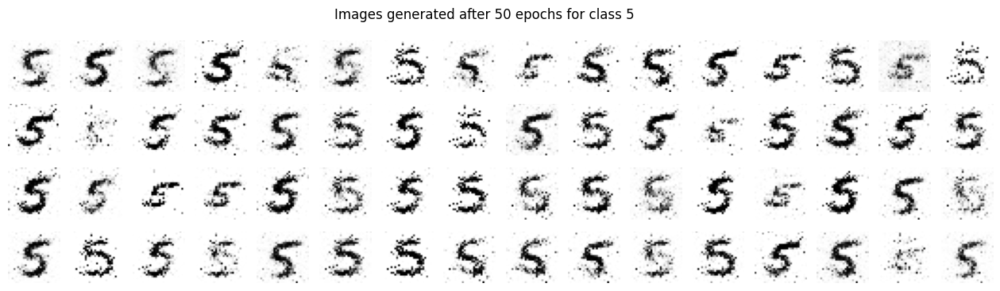

49/49 [==============================] - 2s 35ms/step - discriminator_loss: 0.5964 - generator_loss: 1.2036
Epoch 51/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.5691 - generator_loss: 1.2234
Epoch 52/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.5643 - generator_loss: 1.2090
Epoch 53/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.5798 - generator_loss: 1.2832
Epoch 54/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.5787 - generator_loss: 1.2570
Epoch 55/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.5465 - generator_loss: 1.2848
Epoch 56/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.5760 - generator_loss: 1.2363
Epoch 57/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.6019 - generator_loss: 1.2686
Epoch 58/500
49/49 [=========================

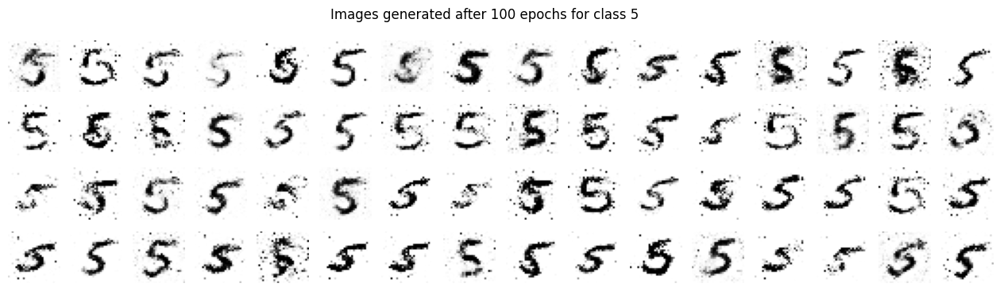

49/49 [==============================] - 1s 30ms/step - discriminator_loss: 0.6214 - generator_loss: 1.0834
Epoch 101/500
49/49 [==============================] - 1s 12ms/step - discriminator_loss: 0.6269 - generator_loss: 1.0483
Epoch 102/500
49/49 [==============================] - 1s 12ms/step - discriminator_loss: 0.6066 - generator_loss: 1.0395
Epoch 103/500
49/49 [==============================] - 1s 12ms/step - discriminator_loss: 0.6098 - generator_loss: 1.0620
Epoch 104/500
49/49 [==============================] - 1s 12ms/step - discriminator_loss: 0.6145 - generator_loss: 1.0633
Epoch 105/500
49/49 [==============================] - 1s 12ms/step - discriminator_loss: 0.6119 - generator_loss: 1.0535
Epoch 106/500
49/49 [==============================] - 1s 12ms/step - discriminator_loss: 0.6156 - generator_loss: 1.0685
Epoch 107/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.6354 - generator_loss: 0.9810
Epoch 108/500
49/49 [=================

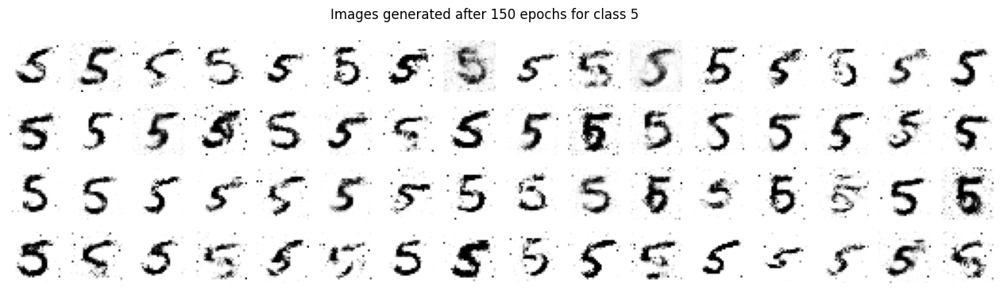

49/49 [==============================] - 2s 31ms/step - discriminator_loss: 0.6531 - generator_loss: 0.9404
Epoch 151/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.6408 - generator_loss: 0.9485
Epoch 152/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.6380 - generator_loss: 0.9525
Epoch 153/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.6493 - generator_loss: 0.9520
Epoch 154/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.6337 - generator_loss: 0.9768
Epoch 155/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.6415 - generator_loss: 0.9641
Epoch 156/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.6541 - generator_loss: 0.9670
Epoch 157/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.6418 - generator_loss: 0.9631
Epoch 158/500
49/49 [=================

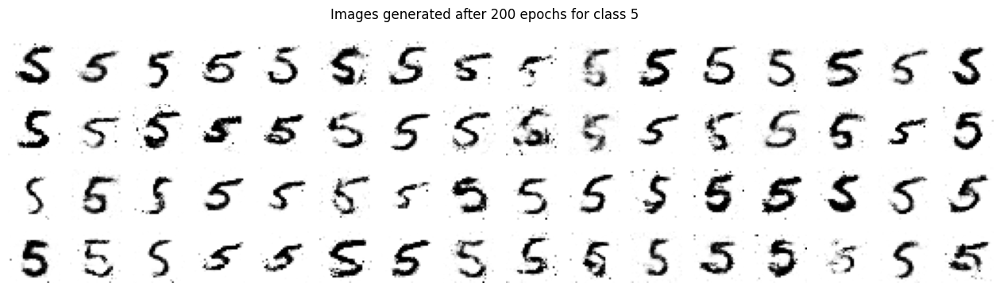

49/49 [==============================] - 1s 31ms/step - discriminator_loss: 0.6617 - generator_loss: 0.9272
Epoch 201/500
49/49 [==============================] - 1s 12ms/step - discriminator_loss: 0.6560 - generator_loss: 0.9243
Epoch 202/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.6571 - generator_loss: 0.9199
Epoch 203/500
49/49 [==============================] - 1s 12ms/step - discriminator_loss: 0.6542 - generator_loss: 0.9218
Epoch 204/500
49/49 [==============================] - 1s 12ms/step - discriminator_loss: 0.6605 - generator_loss: 0.9259
Epoch 205/500
49/49 [==============================] - 1s 12ms/step - discriminator_loss: 0.6598 - generator_loss: 0.9220
Epoch 206/500
49/49 [==============================] - 1s 12ms/step - discriminator_loss: 0.6569 - generator_loss: 0.9187
Epoch 207/500
49/49 [==============================] - 1s 14ms/step - discriminator_loss: 0.6556 - generator_loss: 0.9028
Epoch 208/500
49/49 [=================

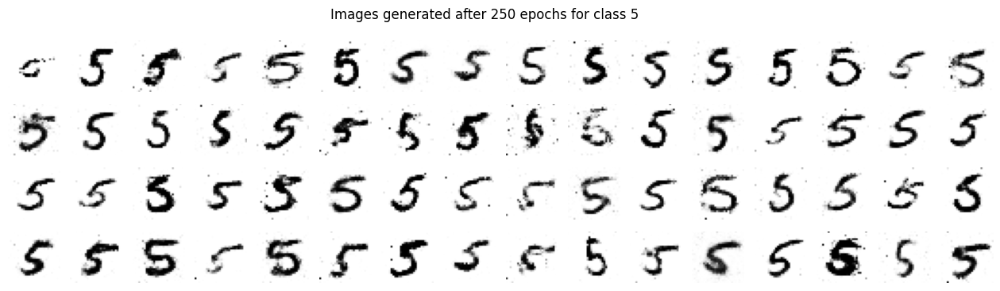

49/49 [==============================] - 2s 31ms/step - discriminator_loss: 0.6494 - generator_loss: 0.9179
Epoch 251/500
49/49 [==============================] - 1s 14ms/step - discriminator_loss: 0.6449 - generator_loss: 0.9319
Epoch 252/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.6481 - generator_loss: 0.9250
Epoch 253/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.6452 - generator_loss: 0.9363
Epoch 254/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.6459 - generator_loss: 0.9432
Epoch 255/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.6478 - generator_loss: 0.9390
Epoch 256/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.6479 - generator_loss: 0.9408
Epoch 257/500
49/49 [==============================] - 1s 14ms/step - discriminator_loss: 0.6431 - generator_loss: 0.9382
Epoch 258/500
49/49 [=================

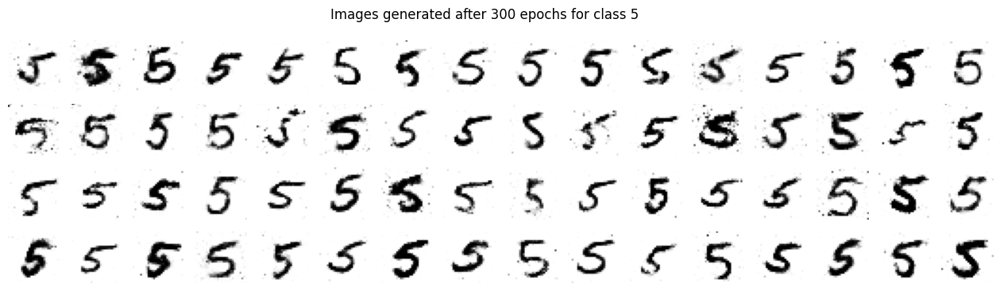

49/49 [==============================] - 1s 30ms/step - discriminator_loss: 0.6271 - generator_loss: 0.9517
Epoch 301/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.6358 - generator_loss: 0.9695
Epoch 302/500
49/49 [==============================] - 1s 12ms/step - discriminator_loss: 0.6240 - generator_loss: 0.9590
Epoch 303/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.6282 - generator_loss: 0.9621
Epoch 304/500
49/49 [==============================] - 1s 12ms/step - discriminator_loss: 0.6281 - generator_loss: 0.9768
Epoch 305/500
49/49 [==============================] - 1s 12ms/step - discriminator_loss: 0.6274 - generator_loss: 0.9564
Epoch 306/500
49/49 [==============================] - 1s 12ms/step - discriminator_loss: 0.6297 - generator_loss: 0.9581
Epoch 307/500
49/49 [==============================] - 1s 12ms/step - discriminator_loss: 0.6293 - generator_loss: 0.9702
Epoch 308/500
49/49 [=================

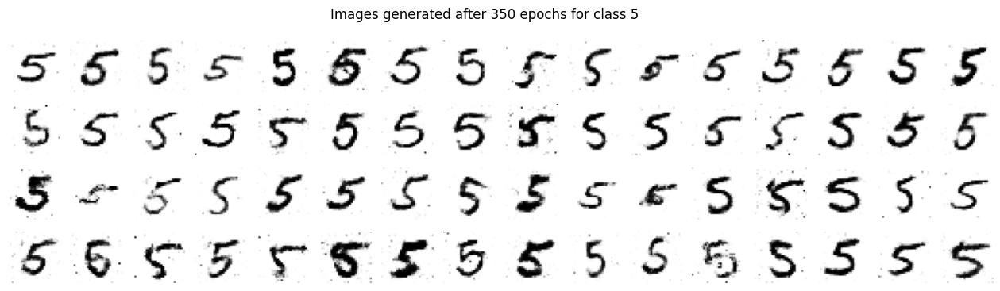

49/49 [==============================] - 2s 31ms/step - discriminator_loss: 0.6030 - generator_loss: 0.9992
Epoch 351/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.6041 - generator_loss: 1.0204
Epoch 352/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.5989 - generator_loss: 1.0131
Epoch 353/500
49/49 [==============================] - 1s 14ms/step - discriminator_loss: 0.6098 - generator_loss: 1.0206
Epoch 354/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.6004 - generator_loss: 1.0012
Epoch 355/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.6041 - generator_loss: 1.0354
Epoch 356/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.5959 - generator_loss: 1.0292
Epoch 357/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.6001 - generator_loss: 1.0160
Epoch 358/500
49/49 [=================

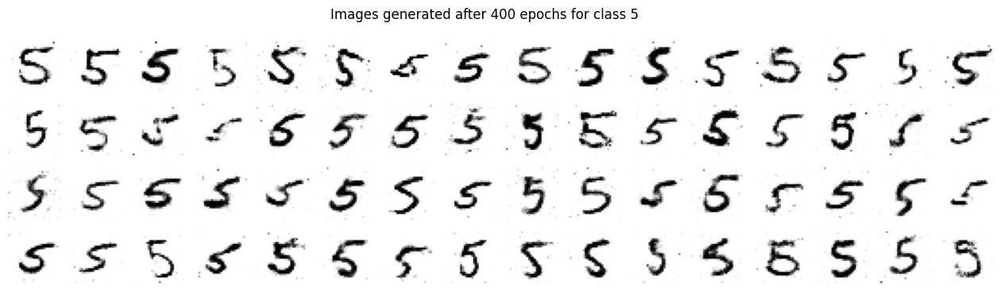

49/49 [==============================] - 1s 31ms/step - discriminator_loss: 0.5718 - generator_loss: 1.0590
Epoch 401/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.5680 - generator_loss: 1.0867
Epoch 402/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.5719 - generator_loss: 1.0788
Epoch 403/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.5709 - generator_loss: 1.0744
Epoch 404/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.5683 - generator_loss: 1.0623
Epoch 405/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.5686 - generator_loss: 1.0851
Epoch 406/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.5702 - generator_loss: 1.0862
Epoch 407/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.5664 - generator_loss: 1.0830
Epoch 408/500
49/49 [=================

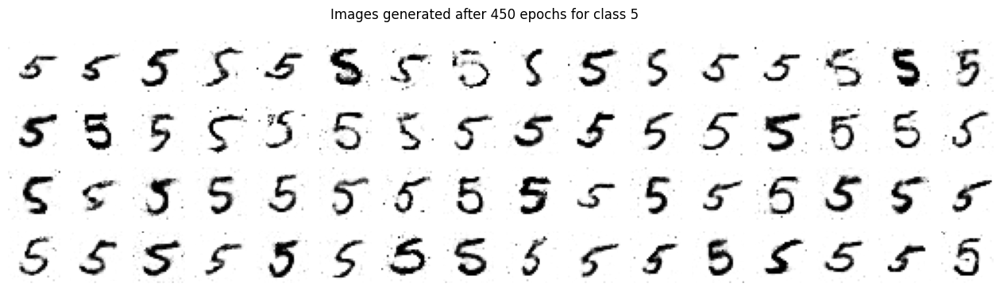

49/49 [==============================] - 2s 33ms/step - discriminator_loss: 0.5325 - generator_loss: 1.1570
Epoch 451/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.5333 - generator_loss: 1.1550
Epoch 452/500
49/49 [==============================] - 1s 14ms/step - discriminator_loss: 0.5364 - generator_loss: 1.1632
Epoch 453/500
49/49 [==============================] - 1s 14ms/step - discriminator_loss: 0.5315 - generator_loss: 1.1631
Epoch 454/500
49/49 [==============================] - 1s 14ms/step - discriminator_loss: 0.5397 - generator_loss: 1.1555
Epoch 455/500
49/49 [==============================] - 1s 14ms/step - discriminator_loss: 0.5244 - generator_loss: 1.1793
Epoch 456/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.5331 - generator_loss: 1.1678
Epoch 457/500
49/49 [==============================] - 1s 13ms/step - discriminator_loss: 0.5322 - generator_loss: 1.1912
Epoch 458/500
49/49 [=================

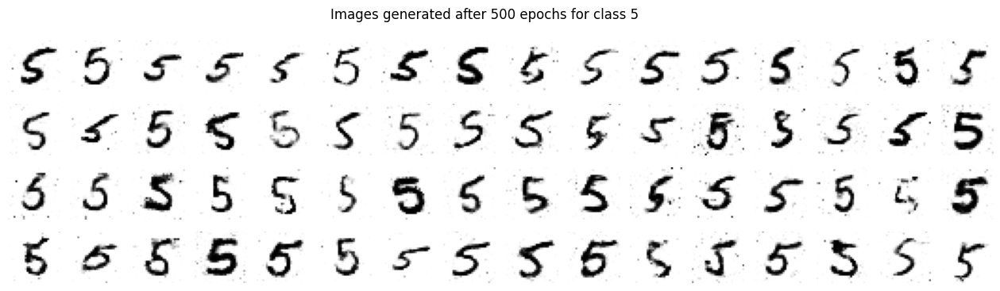

49/49 [==============================] - 2s 31ms/step - discriminator_loss: 0.4992 - generator_loss: 1.2496
Epoch 1/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.5573 - generator_loss: 0.7530
Epoch 2/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6248 - generator_loss: 0.8240
Epoch 3/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.7274 - generator_loss: 0.8657
Epoch 4/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6797 - generator_loss: 0.9458
Epoch 5/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6859 - generator_loss: 0.9166
Epoch 6/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6292 - generator_loss: 0.9579
Epoch 7/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5316 - generator_loss: 1.0412
Epoch 8/500
53/53 [==============================] -

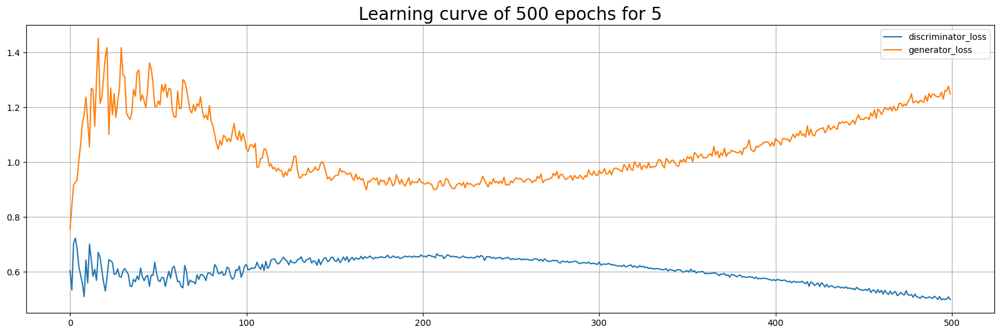

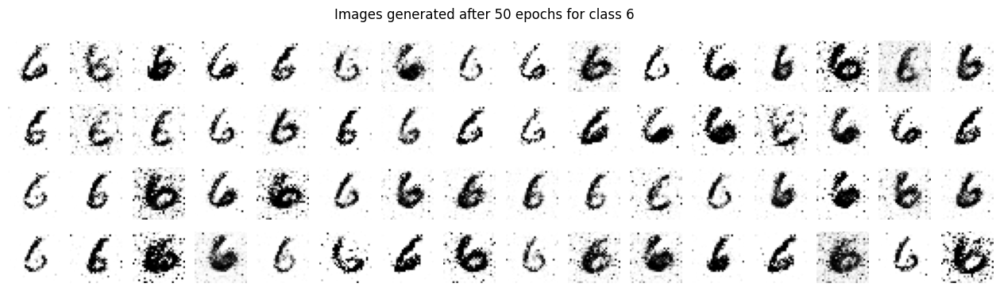

53/53 [==============================] - 2s 33ms/step - discriminator_loss: 0.5564 - generator_loss: 1.2236
Epoch 51/500
53/53 [==============================] - 1s 15ms/step - discriminator_loss: 0.5613 - generator_loss: 1.3362
Epoch 52/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5611 - generator_loss: 1.2828
Epoch 53/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5592 - generator_loss: 1.2253
Epoch 54/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5564 - generator_loss: 1.4224
Epoch 55/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5528 - generator_loss: 1.4474
Epoch 56/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6035 - generator_loss: 1.3591
Epoch 57/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5779 - generator_loss: 1.2082
Epoch 58/500
53/53 [=========================

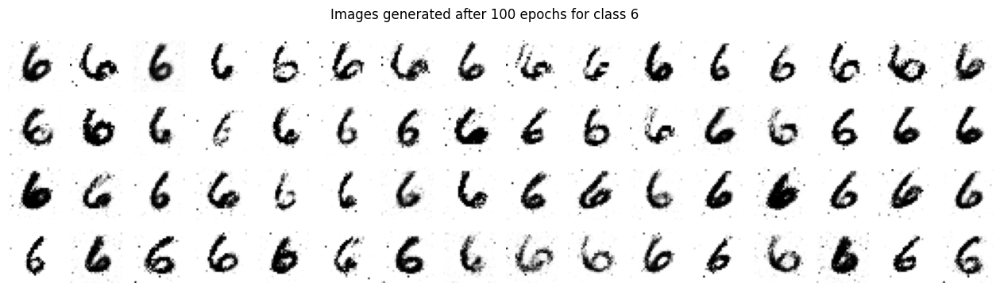

53/53 [==============================] - 2s 29ms/step - discriminator_loss: 0.6501 - generator_loss: 0.9191
Epoch 101/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6594 - generator_loss: 0.9221
Epoch 102/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6530 - generator_loss: 0.9298
Epoch 103/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6652 - generator_loss: 0.9274
Epoch 104/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6655 - generator_loss: 0.8865
Epoch 105/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6591 - generator_loss: 0.8783
Epoch 106/500
53/53 [==============================] - 1s 14ms/step - discriminator_loss: 0.6645 - generator_loss: 0.8782
Epoch 107/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6565 - generator_loss: 0.8849
Epoch 108/500
53/53 [=================

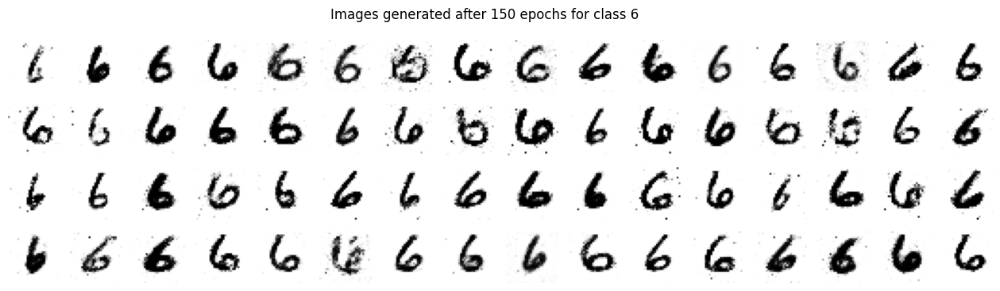

53/53 [==============================] - 2s 30ms/step - discriminator_loss: 0.6783 - generator_loss: 0.8836
Epoch 151/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6794 - generator_loss: 0.8880
Epoch 152/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6731 - generator_loss: 0.8785
Epoch 153/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6689 - generator_loss: 0.8772
Epoch 154/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6657 - generator_loss: 0.8726
Epoch 155/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6688 - generator_loss: 0.8918
Epoch 156/500
53/53 [==============================] - 1s 14ms/step - discriminator_loss: 0.6714 - generator_loss: 0.8845
Epoch 157/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6690 - generator_loss: 0.8941
Epoch 158/500
53/53 [=================

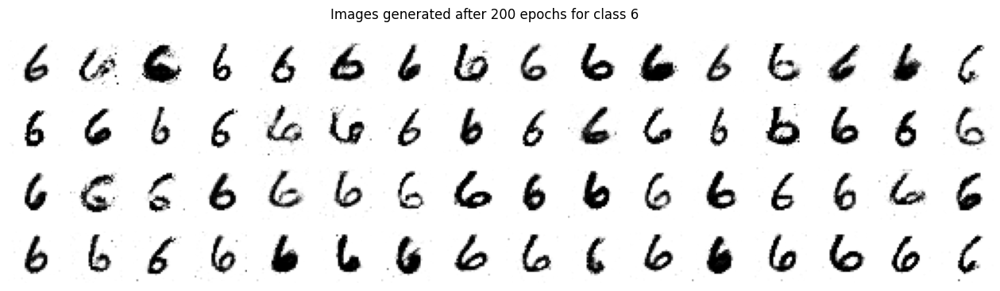

53/53 [==============================] - 2s 34ms/step - discriminator_loss: 0.6664 - generator_loss: 0.8816
Epoch 201/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6660 - generator_loss: 0.8671
Epoch 202/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6609 - generator_loss: 0.8706
Epoch 203/500
53/53 [==============================] - 1s 14ms/step - discriminator_loss: 0.6621 - generator_loss: 0.8696
Epoch 204/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6668 - generator_loss: 0.8667
Epoch 205/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6643 - generator_loss: 0.8801
Epoch 206/500
53/53 [==============================] - 1s 14ms/step - discriminator_loss: 0.6677 - generator_loss: 0.8695
Epoch 207/500
53/53 [==============================] - 1s 14ms/step - discriminator_loss: 0.6699 - generator_loss: 0.8697
Epoch 208/500
53/53 [=================

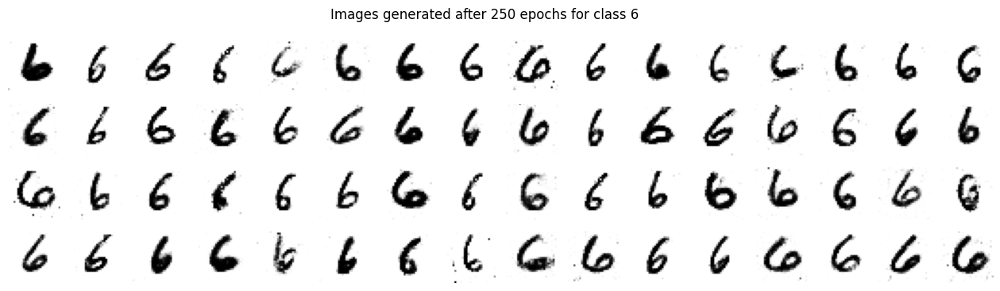

53/53 [==============================] - 2s 30ms/step - discriminator_loss: 0.6682 - generator_loss: 0.8604
Epoch 251/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6703 - generator_loss: 0.8515
Epoch 252/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6716 - generator_loss: 0.8744
Epoch 253/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6637 - generator_loss: 0.8542
Epoch 254/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6683 - generator_loss: 0.8641
Epoch 255/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6684 - generator_loss: 0.8729
Epoch 256/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6671 - generator_loss: 0.8676
Epoch 257/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6660 - generator_loss: 0.8612
Epoch 258/500
53/53 [=================

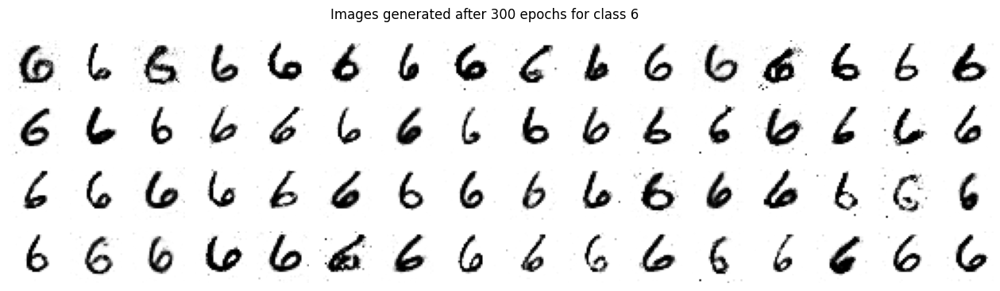

53/53 [==============================] - 2s 29ms/step - discriminator_loss: 0.6570 - generator_loss: 0.8780
Epoch 301/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6535 - generator_loss: 0.8843
Epoch 302/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6568 - generator_loss: 0.8847
Epoch 303/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6570 - generator_loss: 0.8770
Epoch 304/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6560 - generator_loss: 0.8736
Epoch 305/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6590 - generator_loss: 0.8722
Epoch 306/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6586 - generator_loss: 0.8649
Epoch 307/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6557 - generator_loss: 0.8682
Epoch 308/500
53/53 [=================

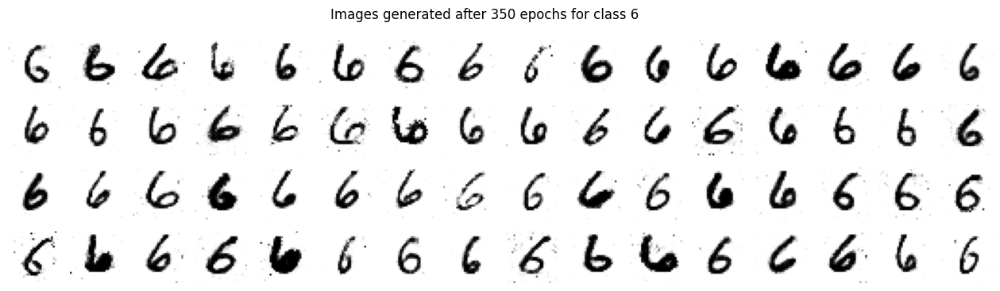

53/53 [==============================] - 2s 30ms/step - discriminator_loss: 0.6471 - generator_loss: 0.9022
Epoch 351/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6442 - generator_loss: 0.9200
Epoch 352/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6428 - generator_loss: 0.9068
Epoch 353/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6454 - generator_loss: 0.8880
Epoch 354/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6420 - generator_loss: 0.8994
Epoch 355/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6421 - generator_loss: 0.9019
Epoch 356/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6440 - generator_loss: 0.9129
Epoch 357/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6433 - generator_loss: 0.9052
Epoch 358/500
53/53 [=================

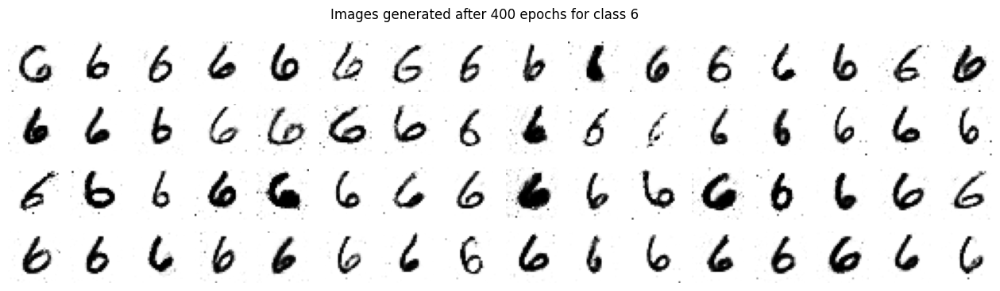

53/53 [==============================] - 2s 29ms/step - discriminator_loss: 0.6223 - generator_loss: 0.9504
Epoch 401/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6283 - generator_loss: 0.9408
Epoch 402/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6239 - generator_loss: 0.9395
Epoch 403/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6240 - generator_loss: 0.9338
Epoch 404/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6217 - generator_loss: 0.9407
Epoch 405/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6221 - generator_loss: 0.9409
Epoch 406/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6230 - generator_loss: 0.9509
Epoch 407/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6218 - generator_loss: 0.9475
Epoch 408/500
53/53 [=================

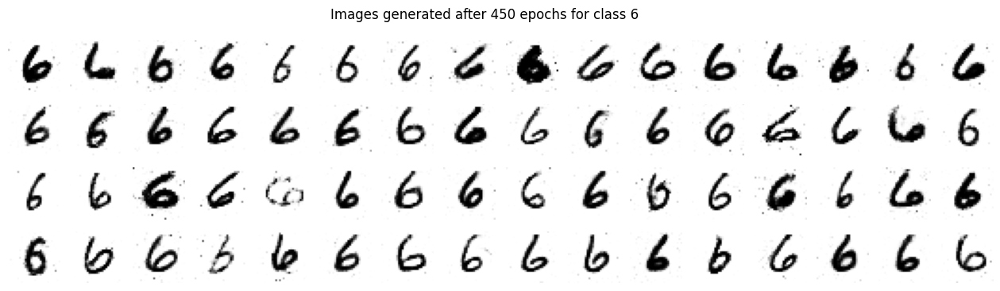

53/53 [==============================] - 2s 29ms/step - discriminator_loss: 0.6045 - generator_loss: 0.9897
Epoch 451/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5997 - generator_loss: 1.0012
Epoch 452/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6006 - generator_loss: 0.9886
Epoch 453/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6058 - generator_loss: 0.9919
Epoch 454/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6001 - generator_loss: 0.9959
Epoch 455/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5965 - generator_loss: 0.9796
Epoch 456/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6001 - generator_loss: 0.9946
Epoch 457/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6012 - generator_loss: 1.0011
Epoch 458/500
53/53 [=================

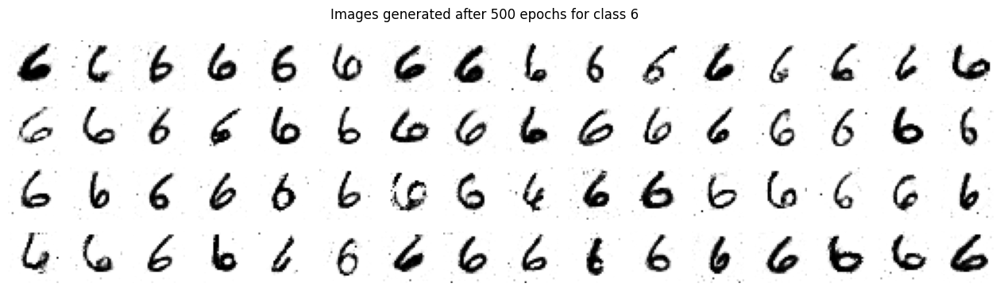

53/53 [==============================] - 2s 29ms/step - discriminator_loss: 0.5808 - generator_loss: 1.0420
Epoch 1/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6084 - generator_loss: 0.7488
Epoch 2/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.5675 - generator_loss: 0.8471
Epoch 3/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.7169 - generator_loss: 0.9275
Epoch 4/500
56/56 [==============================] - 1s 15ms/step - discriminator_loss: 0.7282 - generator_loss: 0.8970
Epoch 5/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6969 - generator_loss: 0.9229
Epoch 6/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6624 - generator_loss: 0.9690
Epoch 7/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6558 - generator_loss: 0.9389
Epoch 8/500
56/56 [==============================] -

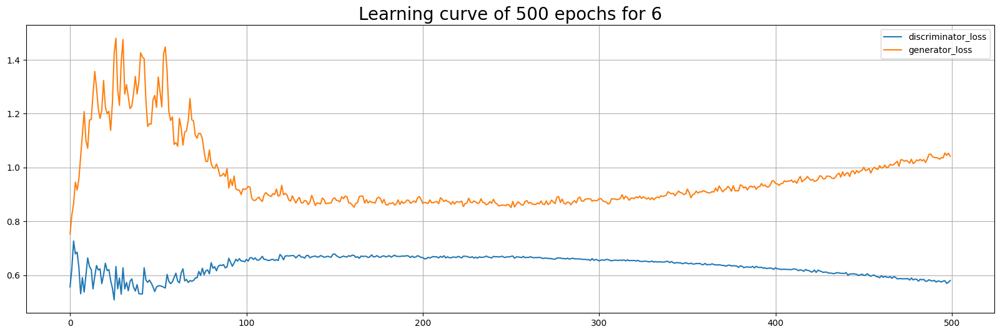

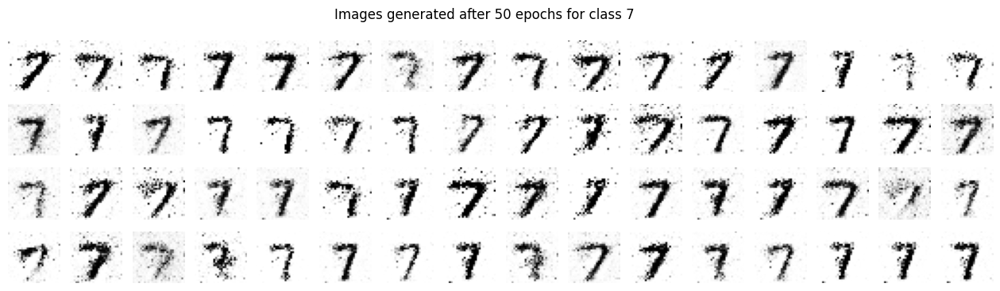

56/56 [==============================] - 2s 30ms/step - discriminator_loss: 0.6261 - generator_loss: 0.9985
Epoch 51/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6382 - generator_loss: 0.9985
Epoch 52/500
56/56 [==============================] - 1s 12ms/step - discriminator_loss: 0.6269 - generator_loss: 0.9722
Epoch 53/500
56/56 [==============================] - 1s 12ms/step - discriminator_loss: 0.6316 - generator_loss: 0.9398
Epoch 54/500
56/56 [==============================] - 1s 12ms/step - discriminator_loss: 0.6224 - generator_loss: 0.9606
Epoch 55/500
56/56 [==============================] - 1s 12ms/step - discriminator_loss: 0.6505 - generator_loss: 0.9584
Epoch 56/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6426 - generator_loss: 0.9413
Epoch 57/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6510 - generator_loss: 0.9457
Epoch 58/500
56/56 [=========================

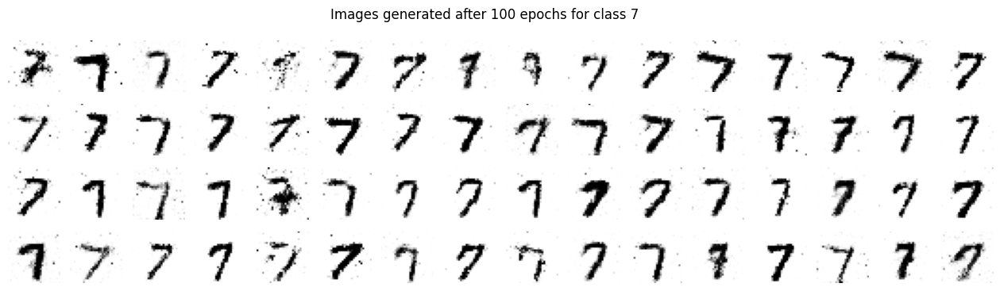

56/56 [==============================] - 2s 28ms/step - discriminator_loss: 0.6726 - generator_loss: 0.8667
Epoch 101/500
56/56 [==============================] - 1s 12ms/step - discriminator_loss: 0.6694 - generator_loss: 0.8831
Epoch 102/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6657 - generator_loss: 0.8608
Epoch 103/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6703 - generator_loss: 0.8642
Epoch 104/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6734 - generator_loss: 0.8803
Epoch 105/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6784 - generator_loss: 0.8861
Epoch 106/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6640 - generator_loss: 0.8765
Epoch 107/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6713 - generator_loss: 0.8674
Epoch 108/500
56/56 [=================

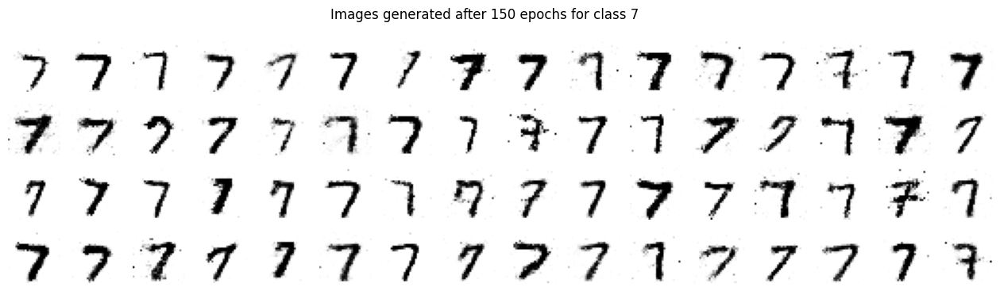

56/56 [==============================] - 2s 28ms/step - discriminator_loss: 0.6783 - generator_loss: 0.8416
Epoch 151/500
56/56 [==============================] - 1s 12ms/step - discriminator_loss: 0.6832 - generator_loss: 0.8286
Epoch 152/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6805 - generator_loss: 0.8212
Epoch 153/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6825 - generator_loss: 0.8266
Epoch 154/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6807 - generator_loss: 0.8312
Epoch 155/500
56/56 [==============================] - 1s 12ms/step - discriminator_loss: 0.6806 - generator_loss: 0.8265
Epoch 156/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6781 - generator_loss: 0.8460
Epoch 157/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6807 - generator_loss: 0.8249
Epoch 158/500
56/56 [=================

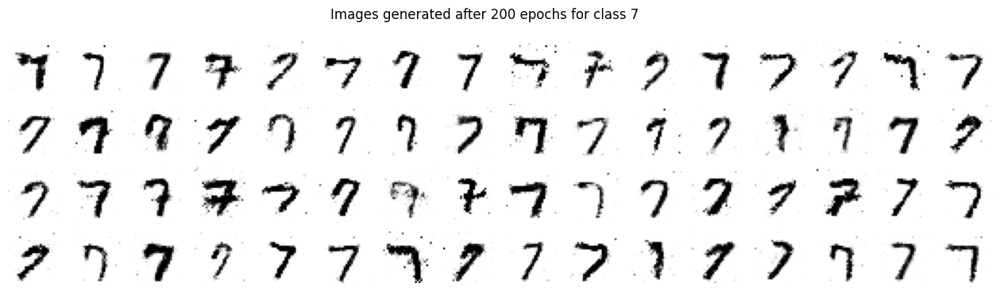

56/56 [==============================] - 2s 28ms/step - discriminator_loss: 0.6788 - generator_loss: 0.8425
Epoch 201/500
56/56 [==============================] - 1s 12ms/step - discriminator_loss: 0.6787 - generator_loss: 0.8410
Epoch 202/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6762 - generator_loss: 0.8412
Epoch 203/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6747 - generator_loss: 0.8480
Epoch 204/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6767 - generator_loss: 0.8400
Epoch 205/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6786 - generator_loss: 0.8373
Epoch 206/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6759 - generator_loss: 0.8378
Epoch 207/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6730 - generator_loss: 0.8407
Epoch 208/500
56/56 [=================

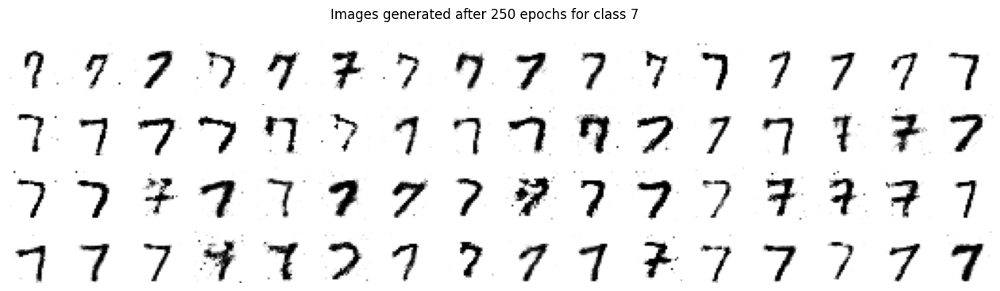

56/56 [==============================] - 2s 27ms/step - discriminator_loss: 0.6738 - generator_loss: 0.8483
Epoch 251/500
56/56 [==============================] - 1s 12ms/step - discriminator_loss: 0.6740 - generator_loss: 0.8473
Epoch 252/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6730 - generator_loss: 0.8361
Epoch 253/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6717 - generator_loss: 0.8316
Epoch 254/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6735 - generator_loss: 0.8331
Epoch 255/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6724 - generator_loss: 0.8432
Epoch 256/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6705 - generator_loss: 0.8346
Epoch 257/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6712 - generator_loss: 0.8309
Epoch 258/500
56/56 [=================

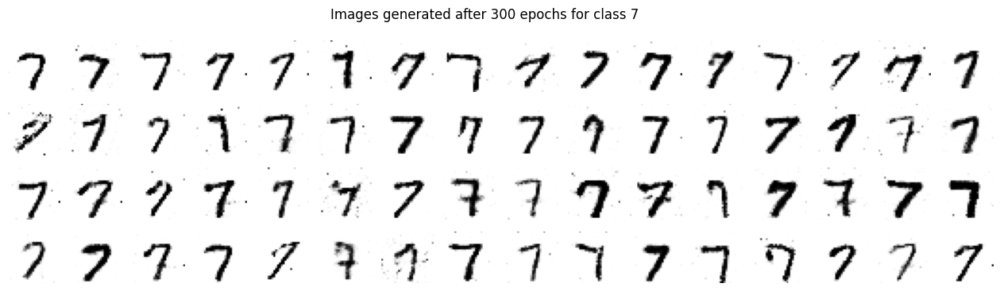

56/56 [==============================] - 2s 28ms/step - discriminator_loss: 0.6686 - generator_loss: 0.8518
Epoch 301/500
56/56 [==============================] - 1s 12ms/step - discriminator_loss: 0.6671 - generator_loss: 0.8500
Epoch 302/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6712 - generator_loss: 0.8425
Epoch 303/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6689 - generator_loss: 0.8326
Epoch 304/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6680 - generator_loss: 0.8508
Epoch 305/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6688 - generator_loss: 0.8430
Epoch 306/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6703 - generator_loss: 0.8515
Epoch 307/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6689 - generator_loss: 0.8482
Epoch 308/500
56/56 [=================

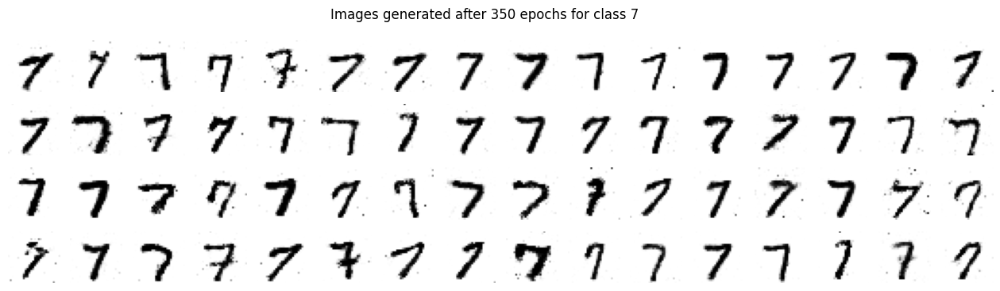

56/56 [==============================] - 2s 27ms/step - discriminator_loss: 0.6604 - generator_loss: 0.8608
Epoch 351/500
56/56 [==============================] - 1s 12ms/step - discriminator_loss: 0.6621 - generator_loss: 0.8562
Epoch 352/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6630 - generator_loss: 0.8609
Epoch 353/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6620 - generator_loss: 0.8481
Epoch 354/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6599 - generator_loss: 0.8425
Epoch 355/500
56/56 [==============================] - 1s 12ms/step - discriminator_loss: 0.6613 - generator_loss: 0.8513
Epoch 356/500
56/56 [==============================] - 1s 12ms/step - discriminator_loss: 0.6588 - generator_loss: 0.8591
Epoch 357/500
56/56 [==============================] - 1s 12ms/step - discriminator_loss: 0.6604 - generator_loss: 0.8678
Epoch 358/500
56/56 [=================

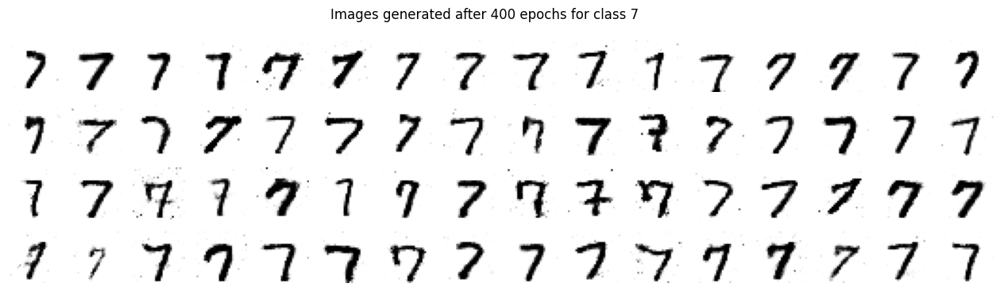

56/56 [==============================] - 2s 28ms/step - discriminator_loss: 0.6540 - generator_loss: 0.8855
Epoch 401/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6523 - generator_loss: 0.8720
Epoch 402/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6519 - generator_loss: 0.8844
Epoch 403/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6482 - generator_loss: 0.8811
Epoch 404/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6509 - generator_loss: 0.8694
Epoch 405/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6487 - generator_loss: 0.8805
Epoch 406/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6477 - generator_loss: 0.8768
Epoch 407/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6520 - generator_loss: 0.8802
Epoch 408/500
56/56 [=================

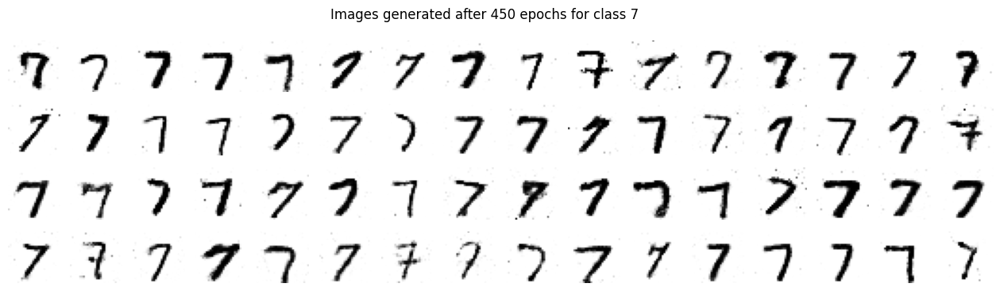

56/56 [==============================] - 2s 29ms/step - discriminator_loss: 0.6362 - generator_loss: 0.8976
Epoch 451/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6390 - generator_loss: 0.8977
Epoch 452/500
56/56 [==============================] - 1s 14ms/step - discriminator_loss: 0.6383 - generator_loss: 0.8944
Epoch 453/500
56/56 [==============================] - 1s 14ms/step - discriminator_loss: 0.6368 - generator_loss: 0.8954
Epoch 454/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6394 - generator_loss: 0.9050
Epoch 455/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6337 - generator_loss: 0.8988
Epoch 456/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6371 - generator_loss: 0.9011
Epoch 457/500
56/56 [==============================] - 1s 13ms/step - discriminator_loss: 0.6381 - generator_loss: 0.8988
Epoch 458/500
56/56 [=================

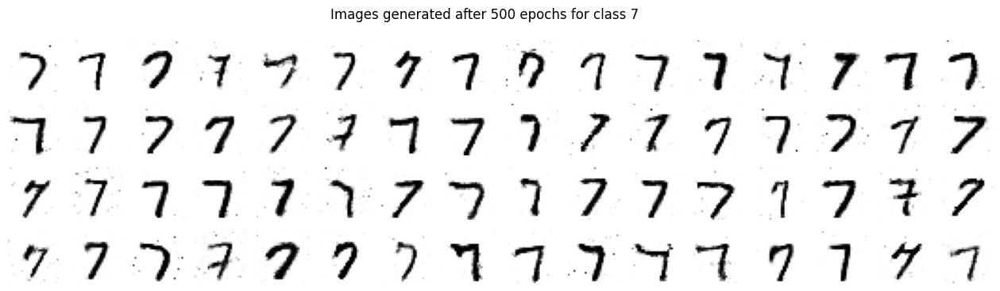

56/56 [==============================] - 2s 28ms/step - discriminator_loss: 0.6206 - generator_loss: 0.9271
Epoch 1/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6161 - generator_loss: 0.7291
Epoch 2/500
53/53 [==============================] - 1s 14ms/step - discriminator_loss: 0.5632 - generator_loss: 0.8138
Epoch 3/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.7003 - generator_loss: 0.9093
Epoch 4/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.7113 - generator_loss: 0.8680
Epoch 5/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.7109 - generator_loss: 0.8719
Epoch 6/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6407 - generator_loss: 0.9661
Epoch 7/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5810 - generator_loss: 1.0211
Epoch 8/500
53/53 [==============================] -

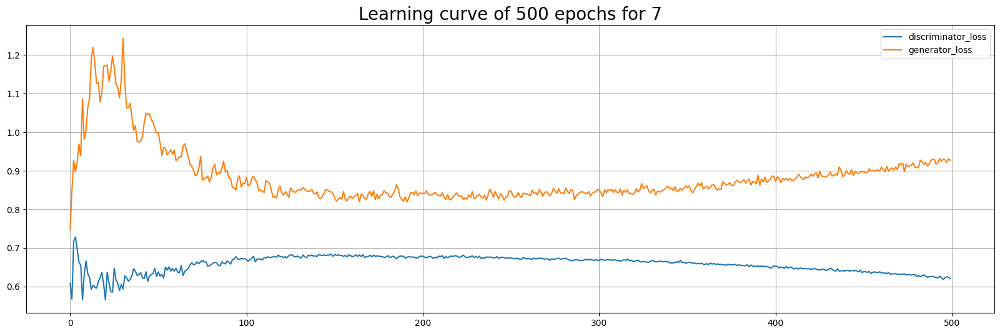

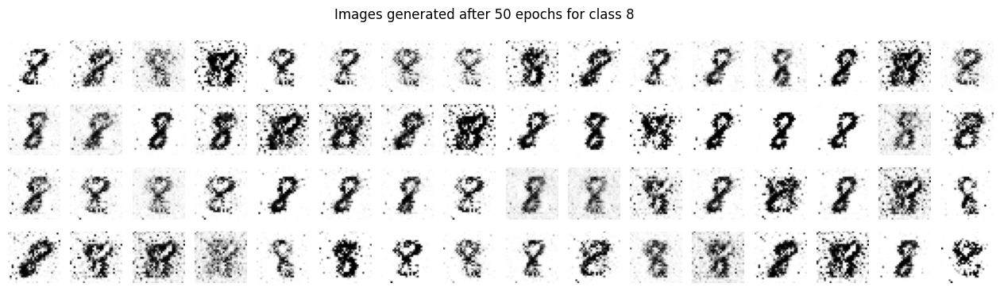

53/53 [==============================] - 2s 31ms/step - discriminator_loss: 0.5785 - generator_loss: 1.3839
Epoch 51/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5170 - generator_loss: 1.3385
Epoch 52/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5602 - generator_loss: 1.2009
Epoch 53/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5545 - generator_loss: 1.2548
Epoch 54/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6019 - generator_loss: 1.2036
Epoch 55/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5723 - generator_loss: 1.1992
Epoch 56/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.5618 - generator_loss: 1.2300
Epoch 57/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5574 - generator_loss: 1.3281
Epoch 58/500
53/53 [=========================

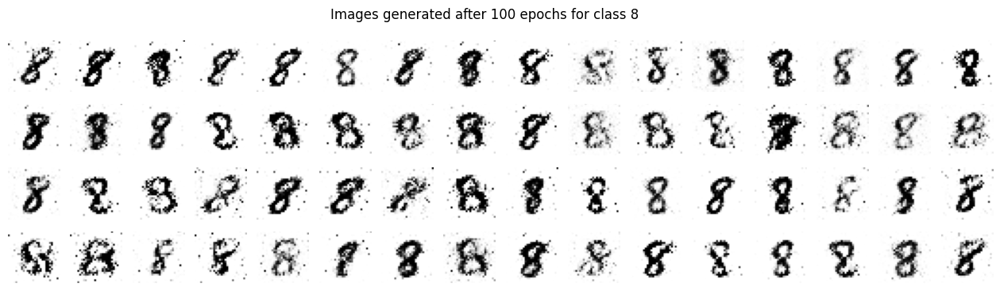

53/53 [==============================] - 2s 30ms/step - discriminator_loss: 0.6049 - generator_loss: 1.2110
Epoch 101/500
53/53 [==============================] - 1s 14ms/step - discriminator_loss: 0.5901 - generator_loss: 1.1591
Epoch 102/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5405 - generator_loss: 1.2177
Epoch 103/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5647 - generator_loss: 1.1800
Epoch 104/500
53/53 [==============================] - 1s 14ms/step - discriminator_loss: 0.5850 - generator_loss: 1.1401
Epoch 105/500
53/53 [==============================] - 1s 14ms/step - discriminator_loss: 0.5805 - generator_loss: 1.1483
Epoch 106/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5847 - generator_loss: 1.1276
Epoch 107/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5924 - generator_loss: 1.1251
Epoch 108/500
53/53 [=================

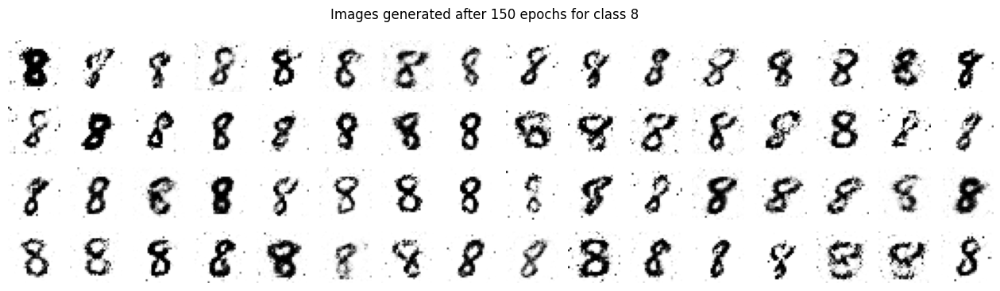

53/53 [==============================] - 2s 29ms/step - discriminator_loss: 0.6237 - generator_loss: 1.0064
Epoch 151/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6207 - generator_loss: 1.0409
Epoch 152/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6371 - generator_loss: 1.0000
Epoch 153/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6374 - generator_loss: 1.0196
Epoch 154/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6335 - generator_loss: 1.0035
Epoch 155/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6369 - generator_loss: 0.9979
Epoch 156/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6308 - generator_loss: 0.9821
Epoch 157/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6278 - generator_loss: 1.0127
Epoch 158/500
53/53 [=================

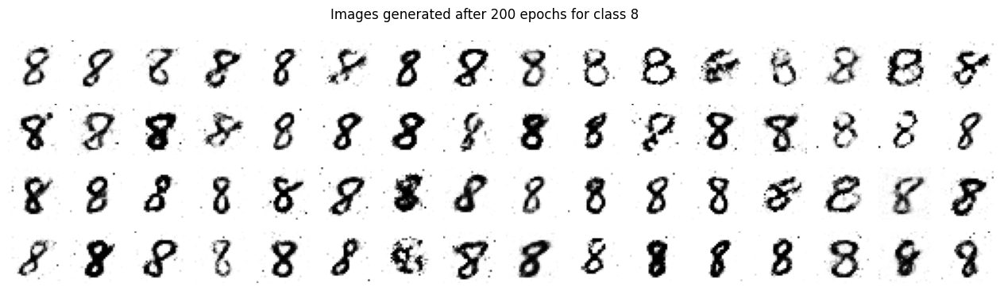

53/53 [==============================] - 2s 32ms/step - discriminator_loss: 0.6439 - generator_loss: 0.9679
Epoch 201/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6314 - generator_loss: 0.9555
Epoch 202/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6375 - generator_loss: 0.9512
Epoch 203/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6366 - generator_loss: 0.9684
Epoch 204/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6410 - generator_loss: 0.9591
Epoch 205/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6415 - generator_loss: 0.9583
Epoch 206/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6435 - generator_loss: 0.9619
Epoch 207/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6426 - generator_loss: 0.9615
Epoch 208/500
53/53 [=================

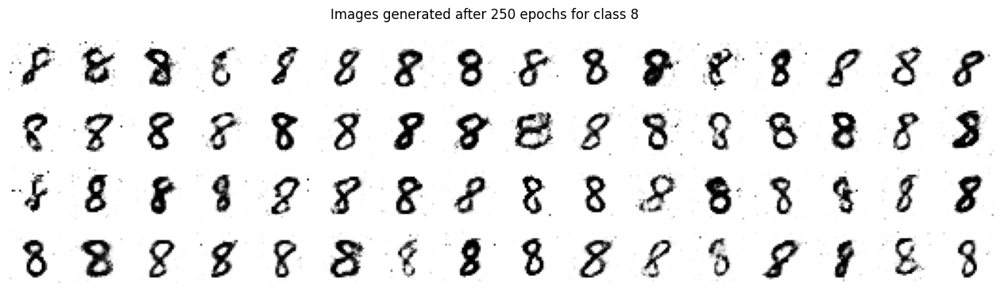

53/53 [==============================] - 1s 26ms/step - discriminator_loss: 0.6276 - generator_loss: 0.9684
Epoch 251/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6299 - generator_loss: 0.9879
Epoch 252/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6305 - generator_loss: 0.9836
Epoch 253/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6258 - generator_loss: 0.9750
Epoch 254/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6270 - generator_loss: 1.0094
Epoch 255/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6310 - generator_loss: 0.9940
Epoch 256/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6285 - generator_loss: 0.9719
Epoch 257/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6263 - generator_loss: 0.9674
Epoch 258/500
53/53 [=================

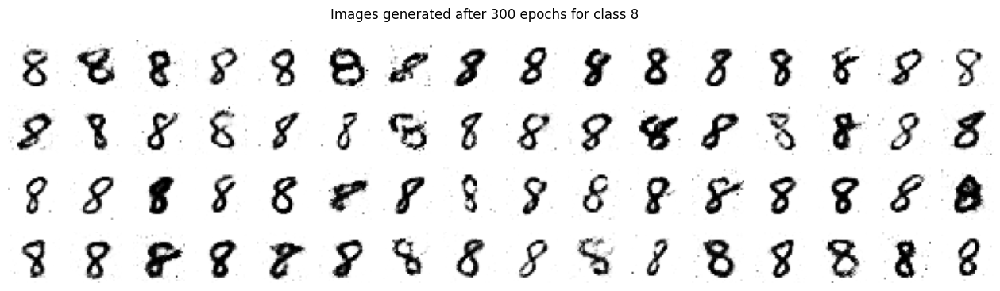

53/53 [==============================] - 2s 32ms/step - discriminator_loss: 0.6053 - generator_loss: 1.0096
Epoch 301/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6045 - generator_loss: 1.0254
Epoch 302/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6095 - generator_loss: 1.0169
Epoch 303/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6034 - generator_loss: 1.0056
Epoch 304/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6099 - generator_loss: 1.0182
Epoch 305/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.6015 - generator_loss: 1.0216
Epoch 306/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6040 - generator_loss: 1.0347
Epoch 307/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.6052 - generator_loss: 1.0038
Epoch 308/500
53/53 [=================

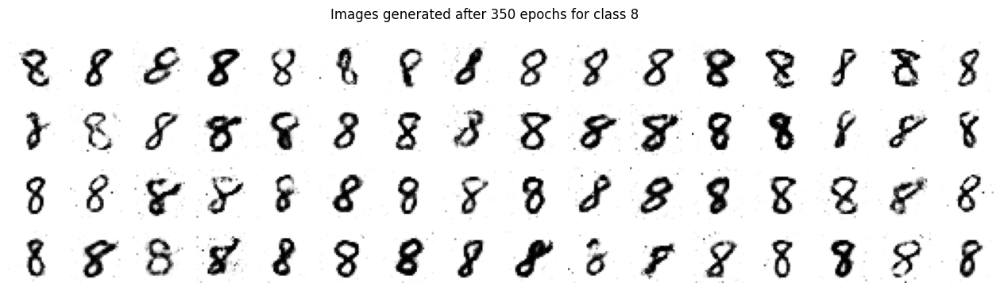

53/53 [==============================] - 2s 30ms/step - discriminator_loss: 0.5850 - generator_loss: 1.0775
Epoch 351/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5715 - generator_loss: 1.0829
Epoch 352/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5778 - generator_loss: 1.0769
Epoch 353/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.5755 - generator_loss: 1.0875
Epoch 354/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.5802 - generator_loss: 1.0962
Epoch 355/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.5747 - generator_loss: 1.0741
Epoch 356/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.5742 - generator_loss: 1.0987
Epoch 357/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5789 - generator_loss: 1.0833
Epoch 358/500
53/53 [=================

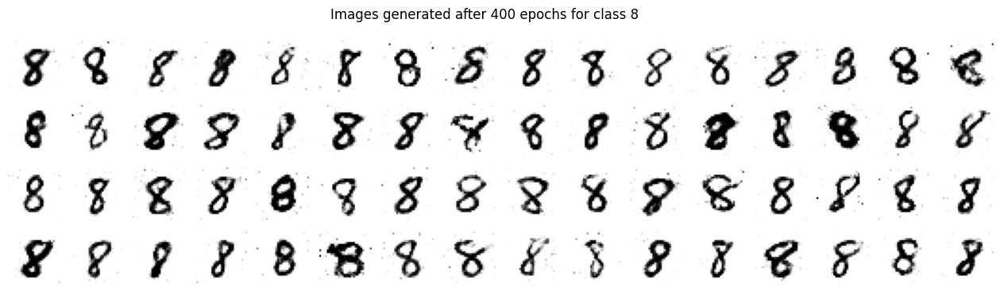

53/53 [==============================] - 2s 29ms/step - discriminator_loss: 0.5421 - generator_loss: 1.1694
Epoch 401/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5382 - generator_loss: 1.1678
Epoch 402/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5328 - generator_loss: 1.1467
Epoch 403/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5356 - generator_loss: 1.1756
Epoch 404/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5449 - generator_loss: 1.1844
Epoch 405/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5376 - generator_loss: 1.1815
Epoch 406/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5387 - generator_loss: 1.1765
Epoch 407/500
53/53 [==============================] - 1s 13ms/step - discriminator_loss: 0.5284 - generator_loss: 1.1661
Epoch 408/500
53/53 [=================

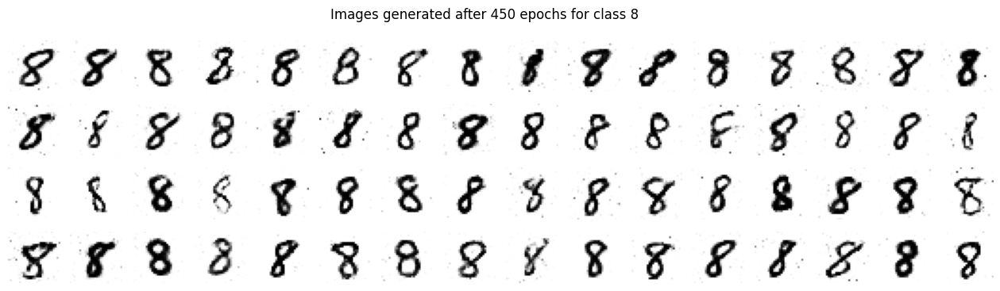

53/53 [==============================] - 1s 28ms/step - discriminator_loss: 0.5011 - generator_loss: 1.2551
Epoch 451/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.5077 - generator_loss: 1.2744
Epoch 452/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.5001 - generator_loss: 1.2794
Epoch 453/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.5041 - generator_loss: 1.2715
Epoch 454/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.4944 - generator_loss: 1.2888
Epoch 455/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.4987 - generator_loss: 1.2758
Epoch 456/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.4985 - generator_loss: 1.2561
Epoch 457/500
53/53 [==============================] - 1s 12ms/step - discriminator_loss: 0.4999 - generator_loss: 1.2657
Epoch 458/500
53/53 [=================

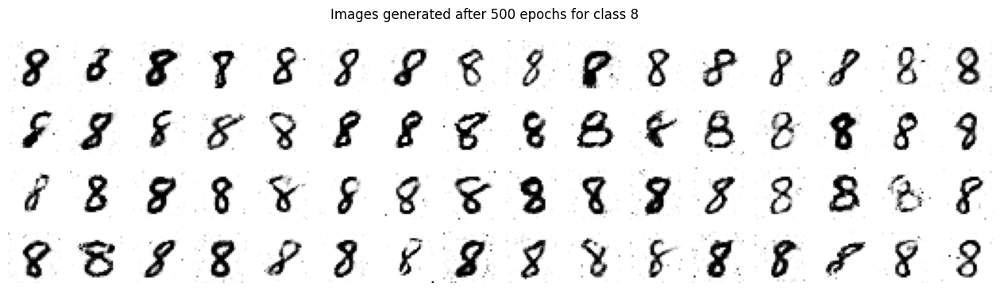

53/53 [==============================] - 2s 29ms/step - discriminator_loss: 0.4696 - generator_loss: 1.3633
Epoch 1/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6286 - generator_loss: 0.7521
Epoch 2/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5538 - generator_loss: 0.8388
Epoch 3/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.7121 - generator_loss: 0.9354
Epoch 4/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.7209 - generator_loss: 0.8908
Epoch 5/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.7373 - generator_loss: 0.9381
Epoch 6/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.6652 - generator_loss: 0.9418
Epoch 7/500
54/54 [==============================] - 1s 12ms/step - discriminator_loss: 0.5882 - generator_loss: 0.9998
Epoch 8/500
54/54 [==============================] -

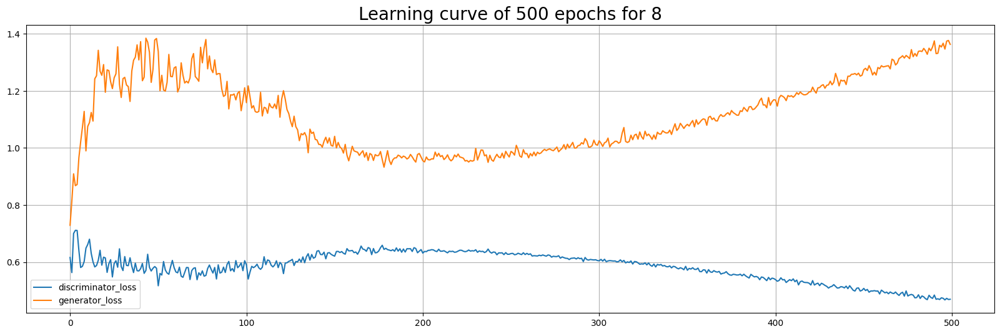

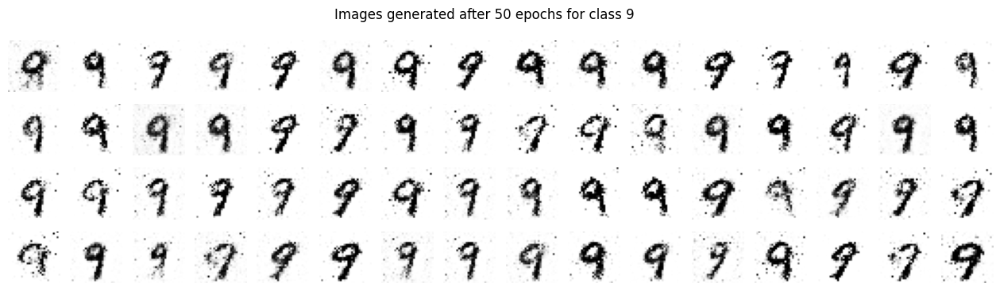

54/54 [==============================] - 2s 31ms/step - discriminator_loss: 0.5866 - generator_loss: 1.1473
Epoch 51/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6228 - generator_loss: 1.0442
Epoch 52/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.5803 - generator_loss: 1.1028
Epoch 53/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6107 - generator_loss: 1.1273
Epoch 54/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6054 - generator_loss: 1.0929
Epoch 55/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6095 - generator_loss: 1.0995
Epoch 56/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.5906 - generator_loss: 1.0935
Epoch 57/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6030 - generator_loss: 1.0726
Epoch 58/500
54/54 [=========================

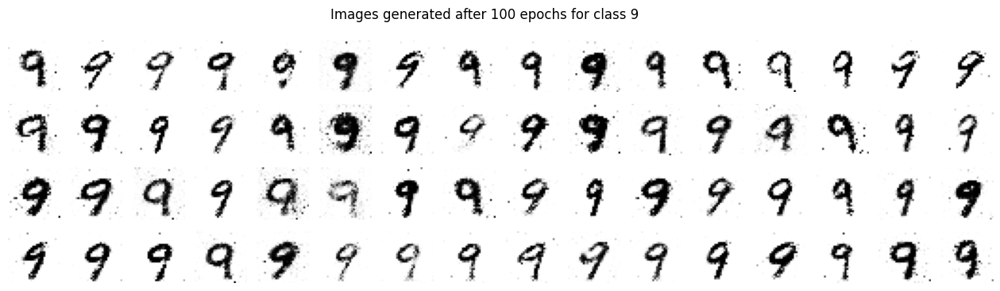

54/54 [==============================] - 2s 31ms/step - discriminator_loss: 0.6637 - generator_loss: 0.8999
Epoch 101/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6554 - generator_loss: 0.9135
Epoch 102/500
54/54 [==============================] - 1s 14ms/step - discriminator_loss: 0.6583 - generator_loss: 0.8993
Epoch 103/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6690 - generator_loss: 0.9119
Epoch 104/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6715 - generator_loss: 0.8740
Epoch 105/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6623 - generator_loss: 0.8850
Epoch 106/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6697 - generator_loss: 0.8681
Epoch 107/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6597 - generator_loss: 0.8955
Epoch 108/500
54/54 [=================

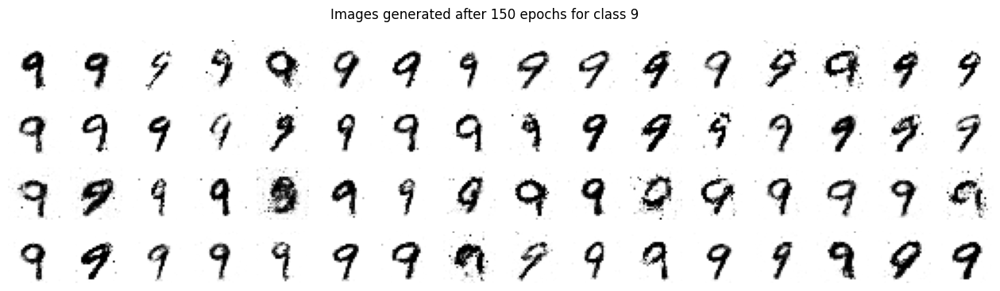

54/54 [==============================] - 2s 29ms/step - discriminator_loss: 0.6832 - generator_loss: 0.8597
Epoch 151/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6783 - generator_loss: 0.8456
Epoch 152/500
54/54 [==============================] - 1s 14ms/step - discriminator_loss: 0.6828 - generator_loss: 0.8355
Epoch 153/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6798 - generator_loss: 0.8354
Epoch 154/500
54/54 [==============================] - 1s 14ms/step - discriminator_loss: 0.6798 - generator_loss: 0.8412
Epoch 155/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6727 - generator_loss: 0.8581
Epoch 156/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6767 - generator_loss: 0.8475
Epoch 157/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6775 - generator_loss: 0.8518
Epoch 158/500
54/54 [=================

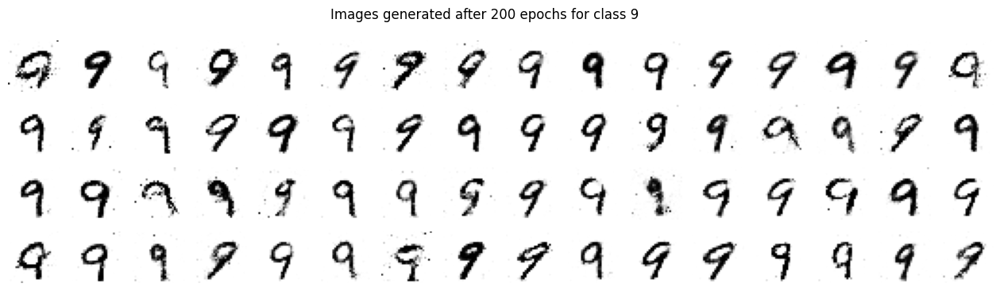

54/54 [==============================] - 2s 29ms/step - discriminator_loss: 0.6736 - generator_loss: 0.8299
Epoch 201/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6730 - generator_loss: 0.8397
Epoch 202/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6775 - generator_loss: 0.8443
Epoch 203/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6753 - generator_loss: 0.8475
Epoch 204/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6752 - generator_loss: 0.8466
Epoch 205/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6729 - generator_loss: 0.8425
Epoch 206/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6792 - generator_loss: 0.8367
Epoch 207/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6733 - generator_loss: 0.8605
Epoch 208/500
54/54 [=================

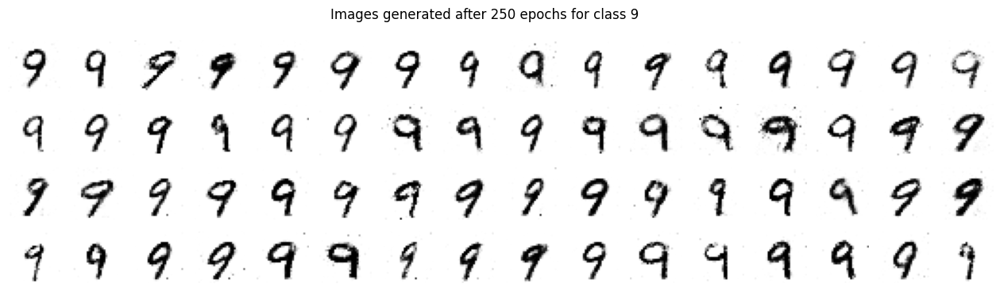

54/54 [==============================] - 2s 30ms/step - discriminator_loss: 0.6750 - generator_loss: 0.8374
Epoch 251/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6756 - generator_loss: 0.8442
Epoch 252/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6724 - generator_loss: 0.8495
Epoch 253/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6725 - generator_loss: 0.8393
Epoch 254/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6752 - generator_loss: 0.8390
Epoch 255/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6715 - generator_loss: 0.8408
Epoch 256/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6760 - generator_loss: 0.8460
Epoch 257/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6751 - generator_loss: 0.8623
Epoch 258/500
54/54 [=================

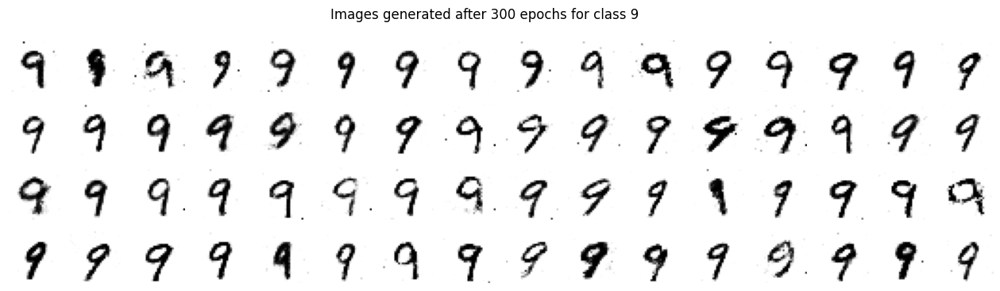

54/54 [==============================] - 2s 29ms/step - discriminator_loss: 0.6716 - generator_loss: 0.8520
Epoch 301/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6684 - generator_loss: 0.8532
Epoch 302/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6699 - generator_loss: 0.8623
Epoch 303/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6683 - generator_loss: 0.8562
Epoch 304/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6701 - generator_loss: 0.8557
Epoch 305/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6669 - generator_loss: 0.8482
Epoch 306/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6681 - generator_loss: 0.8544
Epoch 307/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6690 - generator_loss: 0.8550
Epoch 308/500
54/54 [=================

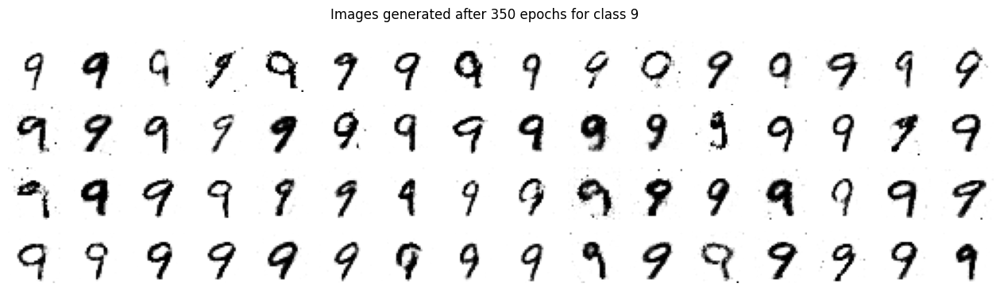

54/54 [==============================] - 2s 29ms/step - discriminator_loss: 0.6647 - generator_loss: 0.8651
Epoch 351/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6625 - generator_loss: 0.8496
Epoch 352/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6647 - generator_loss: 0.8571
Epoch 353/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6589 - generator_loss: 0.8735
Epoch 354/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6620 - generator_loss: 0.8708
Epoch 355/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6660 - generator_loss: 0.8635
Epoch 356/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6619 - generator_loss: 0.8599
Epoch 357/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6633 - generator_loss: 0.8628
Epoch 358/500
54/54 [=================

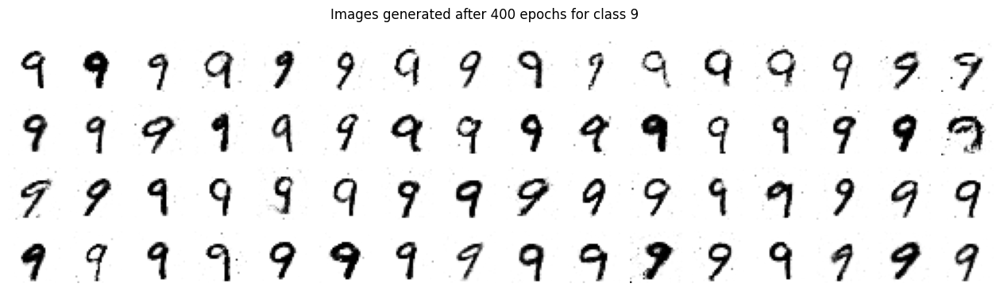

54/54 [==============================] - 2s 29ms/step - discriminator_loss: 0.6541 - generator_loss: 0.8722
Epoch 401/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6533 - generator_loss: 0.8773
Epoch 402/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6546 - generator_loss: 0.8780
Epoch 403/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6557 - generator_loss: 0.8797
Epoch 404/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6558 - generator_loss: 0.8893
Epoch 405/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6498 - generator_loss: 0.8830
Epoch 406/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6503 - generator_loss: 0.8754
Epoch 407/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6561 - generator_loss: 0.8918
Epoch 408/500
54/54 [=================

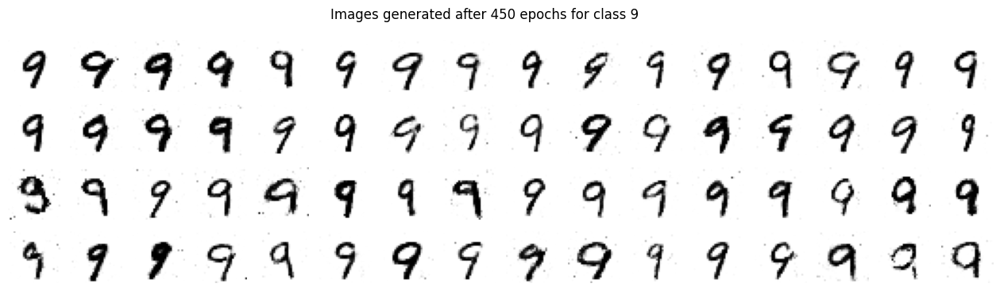

54/54 [==============================] - 2s 29ms/step - discriminator_loss: 0.6403 - generator_loss: 0.9109
Epoch 451/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6385 - generator_loss: 0.9193
Epoch 452/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6396 - generator_loss: 0.8961
Epoch 453/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6373 - generator_loss: 0.9067
Epoch 454/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6338 - generator_loss: 0.9109
Epoch 455/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6359 - generator_loss: 0.9089
Epoch 456/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6333 - generator_loss: 0.9221
Epoch 457/500
54/54 [==============================] - 1s 13ms/step - discriminator_loss: 0.6376 - generator_loss: 0.9284
Epoch 458/500
54/54 [=================

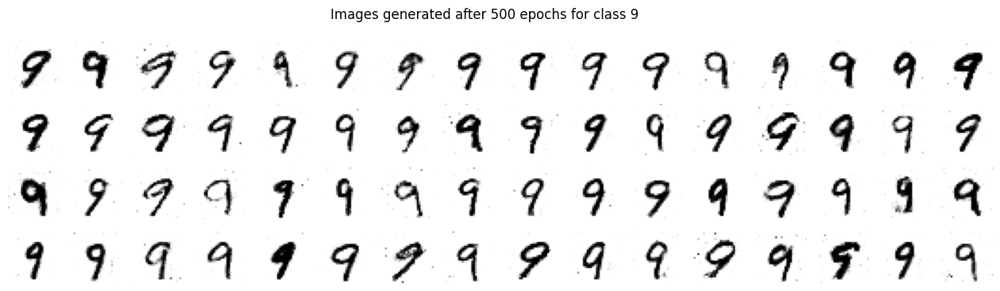

54/54 [==============================] - 2s 29ms/step - discriminator_loss: 0.6121 - generator_loss: 0.9449


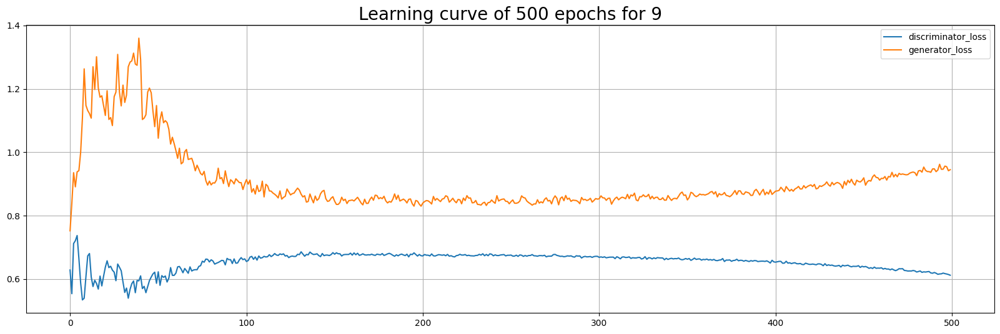

In [12]:
for i in range(10):
    dataset = prepare_mnist_batch(x_train, y_train, i, BATCH_SIZE)
    
    generator = build_generator() 
    discriminator = build_discriminator()
    
    gan = GAN(discriminator = discriminator, generator = generator, latent_dim = NOISE_SIZE)
    
    gan.compile(discriminator_optimizer = Adam(0.0002, 0.5), generator_optimizer = Adam(0.0002, 0.5), loss_fn = keras.losses.BinaryCrossentropy())
    
    history = gan.fit(dataset, epochs = EPOCHS, verbose=1, callbacks = [save_imgs()])
    
    fig, ax = plt.subplots(figsize = (20, 6))
    ax.set_title('Learning curve of {} epochs for {}'.format(EPOCHS, i), fontsize = 20)
    pd.DataFrame(history.history).plot(ax = ax)
    ax.grid()
       
    generator.save('mnist_gan_{}_{}.h5'.format(EPOCHS, i))

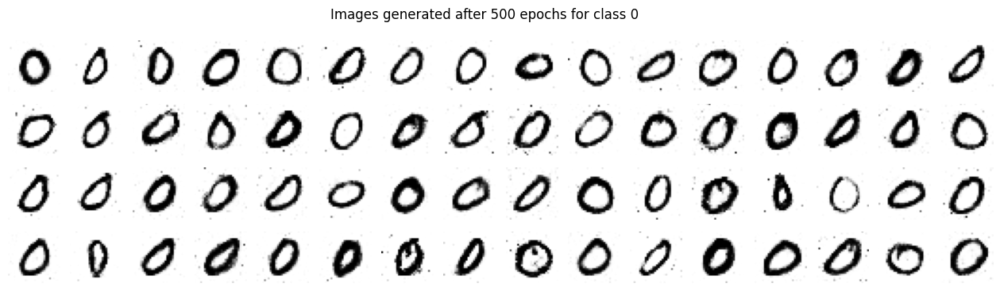

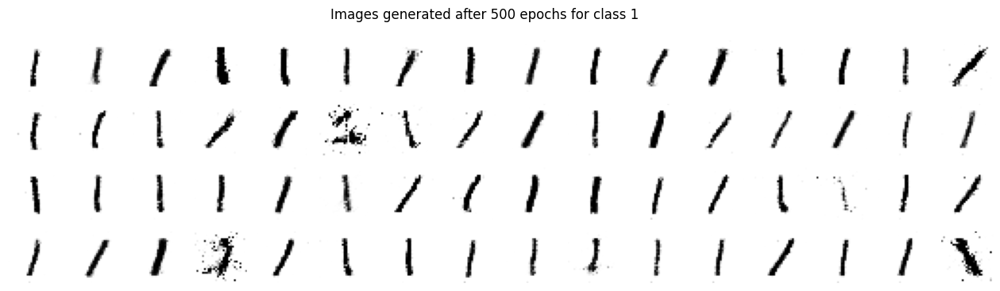

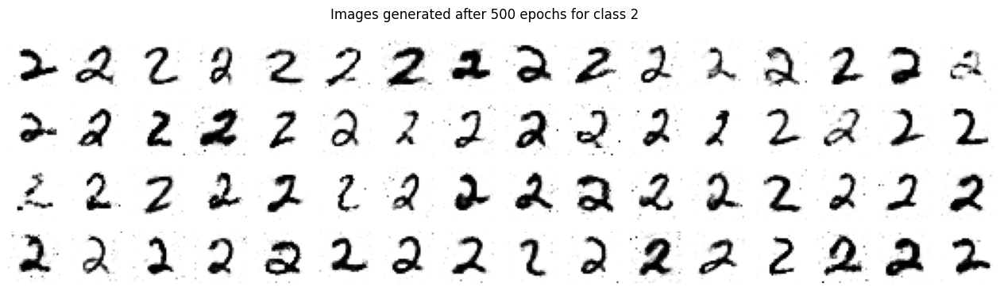

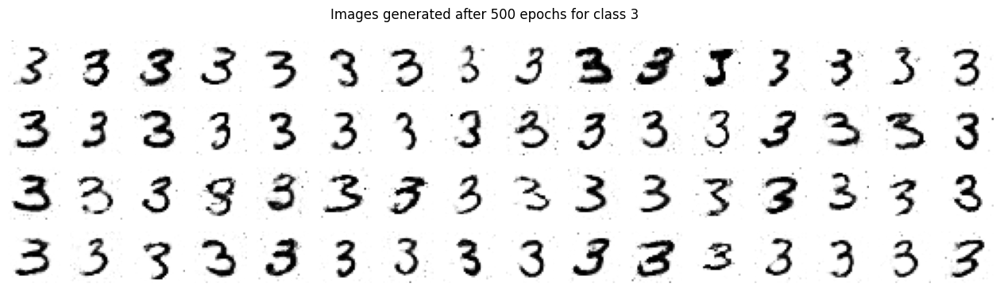

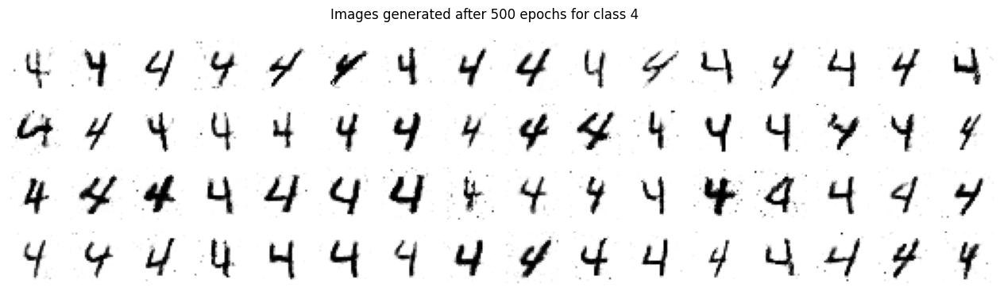

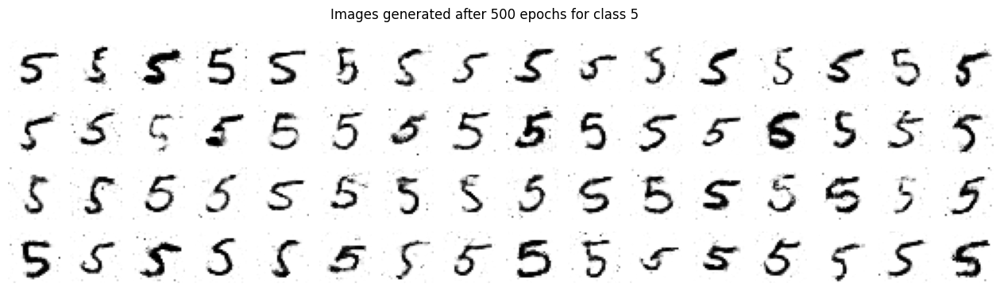

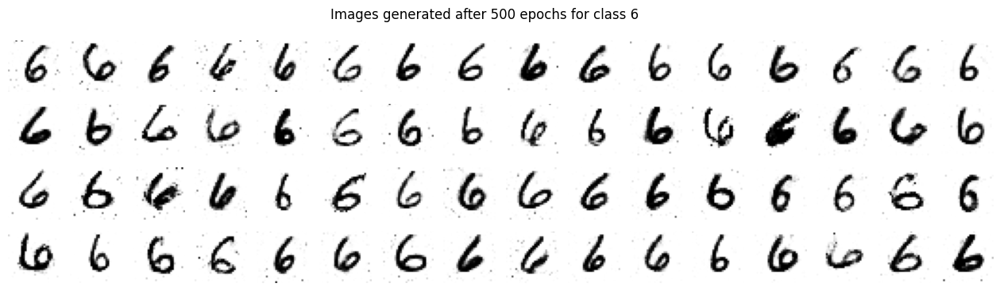

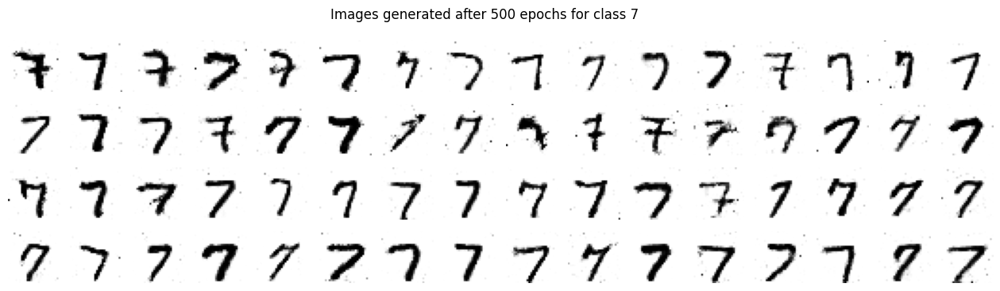

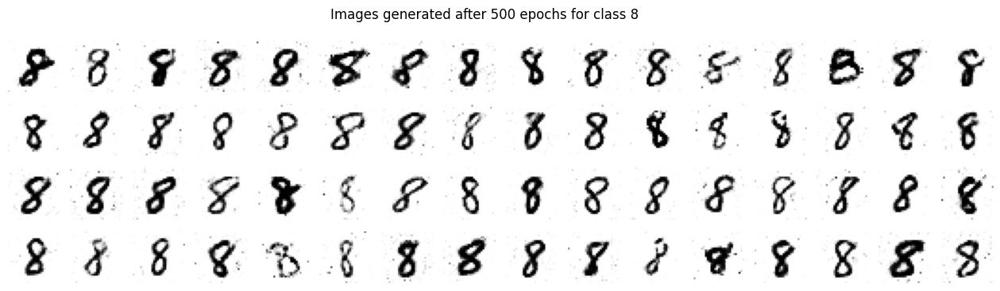

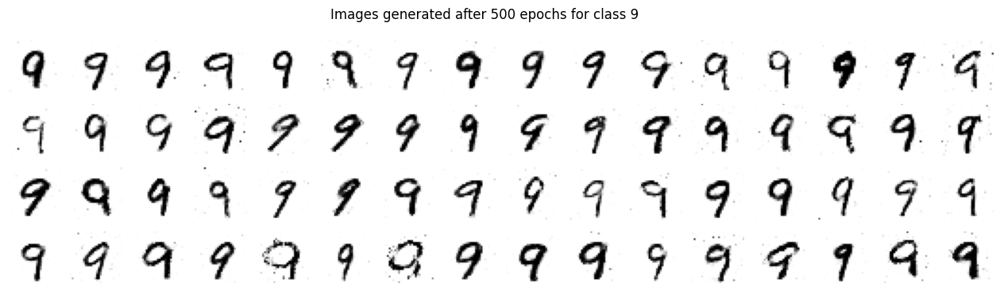

In [13]:
for i in range(10):
    generator = load_model('mnist_gan_{}_{}.h5'.format(EPOCHS, i), compile = False)
    fake_images = generator(tf.random.normal([64, NOISE_SIZE]))
    show_images(fake_images, 16, 'Images generated after {} epochs for class {}'.format(EPOCHS, i),  "res_gen_imgs_{}_{}".format(i, EPOCHS))